In [1]:
import cntk as C
from cntk.device import try_set_default_device, gpu
try_set_default_device(gpu(0))

import numpy as np
import time
import os

from torch.utils.data import DataLoader

In [2]:
# Hessian Vector Product

def grad_inner_product(grad1, grad2):
    # inner product for dictionary-format gradients (output scalar value)
    
    val = 0
    
    assert(len(grad1)==len(grad2))
    
    for ks in grad1.keys():
        val += np.sum(np.multiply(grad1[ks],grad2[ks]))
        
    return val

def weight_update(w, v, r):
    # w: weights of neural network (tuple)
    # v: value for delta w (dictionary, e.g., gradient value)
    # r: hyperparameter for a gradient (scalar)

    for p in w:
        p.value += r * v[p]

def HVP(y, x, v):
    # Calculate Hessian vector product 
    # y: scalar function to be differentiated (function, e.g. cross entropy loss)
    # x: feed_dict value for the network (dictionary, e.g. {model.X: image_batch, model.y: label_batch})
    # v: vector to be producted (by Hessian) (numeric dictionary, e.g., g(z_test))
    ## w: variables to differentiate (numeric, e.g. neural network weight)
    
    # hyperparameter r
    r = 1e-2
    
    assert type(x)==dict, "Input of HVP is wrong. 'x' should be dictionary(feed dict format)"
    assert type(v)==dict, "Input of HVP is wrong. 'v' should be dictionary(weight:value format)"

    w = v.keys()
    
    # gradient for plus
    weight_update(w, v, +r)
    g_plus = y.grad(x, wrt=w)
  
    # gradient for minus
    weight_update(w, v, -2*r)
    g_minus = y.grad(x, wrt=w)
    
    # weight reconstruction
    weight_update(w, v, +r)
    
    hvp = {ks: (g_plus[ks] - g_minus[ks])/(2*r) for ks in g_plus.keys()}
       
    return hvp


In [3]:
# Newton-Conjugate Gradient

from scipy.optimize import fmin_ncg

def dic2vec(dic):
    # convert a dictionary with matrix values to a 1D vector
    # e.g. gradient of network -> 1D vector
    vec = np.concatenate([val.reshape(-1) for val in dic.values()])
    
    return vec

def vec2dic(vec, fmt):
    # convert a 1D vector to a dictionary of format fmt
    # fmt = {key: val.shape for (key,val) in dict}
    fmt_idx = [np.prod(val) for val in fmt.values()]
    #lambda ls, idx: [ls[sum(idx[:i]):sum(idx[:i+1])] for i in range(len(idx))]
    vec_split = [vec[sum(fmt_idx[:i]):sum(fmt_idx[:i+1])] for i in range(len(fmt_idx))]
    dic = {key: vec_split[i].reshape(shape) for (i,(key,shape)) in enumerate(fmt.items())}

    return dic

def get_inverse_hvp_ncg(model, y, v, data_set, **kwargs):
    # return x, which is the solution of QP, whose value is H^-1 v
    # kwargs: hyperparameters for conjugate gradient
    batch_size = kwargs.pop('batch_size', 50)
    damping = kwargs.pop('damping', 0.0)
    avextol = kwargs.pop('avextol', 1e-8)
    maxiter = kwargs.pop('maxiter', 1e1)
    
    dataloader = DataLoader(data_set, batch_size, shuffle=True, num_workers=6)
    
    t0 = time.time()
    get_inverse_hvp_ncg.cnt = 0

    def HVP_minibatch_val(y, v):
        # Calculate Hessian vector product w.r.t whole dataset
        # y: scalar function output of the neural network (e.g. model.loss)
        # v: vector to be producted by inverse hessian (i.e.H^-1 v) (numeric dictionary, e.g. v_test)
        
        ## model: neural network model (e.g. model)
        ## dataloader: training set dataloader
        ## damping: damp term to make hessian convex

        hvp_batch = {ks: [] for ks in v.keys()}

        for img, lb in dataloader:
            img = img.numpy(); lb = lb.numpy()
            x_feed = {model.X: img, model.y:lb}
            hvp = HVP(y,x_feed,v)
            # add hvp value
            [hvp_batch[ks].append(hvp[ks]/img.shape[0]) for ks in hvp.keys()]

        hvp_mean = {ks: np.mean(hvp_batch[ks], axis=0) + damping*v[ks] for ks in hvp_batch.keys()}

        return hvp_mean

    def get_fmin_loss(x):
        x_dic = vec2dic(x, {key: val.shape for (key, val) in v.items()})
        hvp_val = HVP_minibatch_val(y, x_dic)

        return 0.5 * grad_inner_product(hvp_val, x_dic) - grad_inner_product(v, x_dic)

    def get_fmin_grad(x):
        # x: 1D vector
        x_dic = vec2dic(x, {key: val.shape for (key, val) in v.items()})
        hvp_val = HVP_minibatch_val(y, x_dic)
        hvp_flat = dic2vec(hvp_val)
        v_flat = dic2vec(v)

        return hvp_flat - v_flat
    
    def get_fmin_hvp(x, p):
        p_dic = vec2dic(p, {key: val.shape for (key, val) in v.items()})
        hvp_val = HVP_minibatch_val(y, p_dic)
        hvp_flat = dic2vec(hvp_val)

        return hvp_flat

    def ncg_callback(x):
        x_dic = vec2dic(x, {key: val.shape for (key, val) in v.items()})
        print('iteration: {}'.format(get_inverse_hvp_ncg.cnt), ', ', time.time()-t0, '(sec) elapsed')
        print('vector element-wise square: ', grad_inner_product(x_dic, x_dic))
        get_inverse_hvp_ncg.cnt += 1
        
        return 0
    
    fmin_loss_fn = get_fmin_loss
    fmin_grad_fn = get_fmin_grad
    fmin_hvp_fn = get_fmin_hvp
    
    fmin_results = fmin_ncg(\
            f = fmin_loss_fn, x0 = dic2vec(v), fprime = fmin_grad_fn,\
            fhess_p = fmin_hvp_fn, avextol = avextol, maxiter = maxiter, callback=ncg_callback)
    
    return vec2dic(fmin_results, {key: val.shape for (key, val) in v.items()})

In [4]:
# Conjugate Gradient

from scipy.optimize import fmin_cg

def dic2vec(dic):
    # convert a dictionary with matrix values to a 1D vector
    # e.g. gradient of network -> 1D vector
    vec = np.concatenate([val.reshape(-1) for val in dic.values()])
    
    return vec

def vec2dic(vec, fmt):
    # convert a 1D vector to a dictionary of format fmt
    # fmt = {key: val.shape for (key,val) in dict}
    fmt_idx = [np.prod(val) for val in fmt.values()]
    #lambda ls, idx: [ls[sum(idx[:i]):sum(idx[:i+1])] for i in range(len(idx))]
    vec_split = [vec[sum(fmt_idx[:i]):sum(fmt_idx[:i+1])] for i in range(len(fmt_idx))]
    dic = {key: vec_split[i].reshape(shape) for (i,(key,shape)) in enumerate(fmt.items())}

    return dic

def get_inverse_hvp_cg(model, y, v, data_set, **kwargs):
    # return x, which is the solution of QP, whose value is H^-1 v
    # kwargs: hyperparameters for conjugate gradient
    batch_size = kwargs.pop('batch_size', 50)
    damping = kwargs.pop('damping', 0.0)
    maxiter = kwargs.pop('maxiter', 5e1)
    
    dataloader = DataLoader(data_set, batch_size, shuffle=True, num_workers=6)
    
    t0 = time.time()
    get_inverse_hvp_cg.cnt = 0

    def HVP_minibatch_val(y, v):
        # Calculate Hessian vector product w.r.t whole dataset
        # y: scalar function output of the neural network (e.g. model.loss)
        # v: vector to be producted by inverse hessian (i.e.H^-1 v) (numeric dictionary, e.g. v_test)
        
        ## model: neural network model (e.g. model)
        ## dataloader: training set dataloader
        ## damping: damp term to make hessian convex
        
        num_data = data_set.__len__()

        hvp_batch = {key: np.zeros_like(value) for key,value in v.items()}

        for img, lb in dataloader:
            img = img.numpy(); lb = lb.numpy()
            x_feed = {model.X: img, model.y:lb}
            hvp = HVP(y,x_feed,v)
            # add hvp value
            for ks in hvp.keys():
                hvp_batch[ks] += hvp[ks]/num_data
                
        return hvp_batch

    def fmin_loss_fn(x):
        x_dic = vec2dic(x, {key: val.shape for (key, val) in v.items()})
        hvp_val = HVP_minibatch_val(y, x_dic)

        return 0.5 * grad_inner_product(hvp_val, x_dic) - grad_inner_product(v, x_dic)

    def fmin_grad_fn(x):
        # x: 1D vector
        x_dic = vec2dic(x, {key: val.shape for (key, val) in v.items()})
        hvp_val = HVP_minibatch_val(y, x_dic)
        hvp_flat = dic2vec(hvp_val)
        v_flat = dic2vec(v)

        return hvp_flat - v_flat
    
    def cg_callback(x):
        x_dic = vec2dic(x, {key: val.shape for (key, val) in v.items()})
        print('iteration: {}'.format(get_inverse_hvp_cg.cnt), ', ', time.time()-t0, '(sec) elapsed')
        print('vector element-wise square: ', grad_inner_product(x_dic, x_dic))
        get_inverse_hvp_cg.cnt += 1
        
        return 0
    
    fmin_results = fmin_cg(f=fmin_loss_fn, x0=dic2vec(v), fprime=fmin_grad_fn, callback=cg_callback, maxiter=maxiter)
    
    return vec2dic(fmin_results, {key: val.shape for (key, val) in v.items()})

In [5]:
# Stochastic Estimation

def get_inverse_hvp_se(model, y, v, data_set, **kwargs):
    # Calculate inverse hessian vector product over the training set
    # model: neural network model (e.g. model)
    # y: scalar function output of the neural network (e.g. model.loss)
    # v: vector to be producted by inverse hessian (i.e.H^-1 v) (e.g. v_test)
    # data_set: training set to be summed in Hessian
    # kwargs: hyperparameters for stochastic estimation
    
    # hyperparameters
    recursion_depth = kwargs.pop('recursion_depth', 50) # epoch
    scale = kwargs.pop('scale', 1e1) # similar to learning rate
    damping = kwargs.pop('damping', 0.0) # paper reference: 0.01
    batch_size = kwargs.pop('batch_size', 1)
    num_samples = kwargs.pop('num_samples', 1) # the number of samples(:stochatic estimation of IF) to be averaged
    tolerance = kwargs.pop('tolerance', 1e-2) # the difference btw l2 norms of current and previous vector used for early stopping
    verbose = kwargs.pop('verbose', False)
    
    dataloader = DataLoader(data_set, batch_size, shuffle=True, num_workers=6)
    
    inv_hvps = []
    
    params = v.keys()
    
    for i in range(num_samples):
        # obtain num_samples inverse hvps
        cur_estimate = v
        prev_norm = 0
        
        for depth in range(recursion_depth):
            # epoch-scale recursion depth
            t1 = time.time()
            for img, lb in dataloader:
                img = img.numpy(); lb = lb.numpy()
                x_feed = {model.X: img, model.y:lb}
                hvp = HVP(y,x_feed,cur_estimate)
                # cur_estimate = v + (1-damping)*cur_estimate + 1/scale*(hvp/batch_size)
                cur_estimate = {ks: v[ks] + (1-damping/scale)*cur_estimate[ks] - (1/scale)*hvp[ks]/batch_size for ks in cur_estimate.keys()}
            
            if verbose:
                print('#w: \n', list(map(lambda x: x.value, params)), '\n#hvp: \n', hvp, '\n#ihvp: \n', cur_estimate)
            
            cur_norm = np.sqrt(grad_inner_product(cur_estimate,cur_estimate))
            print('Recursion depth: {}, norm: {}, time: {} \n'.format(depth, cur_norm,time.time()-t1))
            
            # divergence check
            if np.isnan(cur_norm):
                print('## The result has been diverged ##')
                break
            
            # convergence check
            if np.abs(cur_norm - prev_norm) <= tolerance:
                # change this to more precise one (<- scipy.fmin_cg also use gnorm)
                print('## Early stopped due to small change')
                break
            prev_norm = cur_norm
        
        inv_hvp = {ks: (1/scale)*cur_estimate[ks] for ks in cur_estimate.keys()}
        inv_hvps.append(inv_hvp)
    
    inv_hvp_val = {ks: np.mean([inv_hvps[i][ks] for i in range(num_samples)], axis=0) for ks in inv_hvps[0].keys()}
    
    return inv_hvp_val

In [6]:
# toy example for inverse HVP (CG, NCG and SE)

class SimpleNet(object):
    def __init__(self):
        self.X = C.input_variable(shape=(1,))
        self.h = C.layers.Dense(1, activation=None, init=C.uniform(1), bias=False)(self.X)
        self.pred = C.layers.Dense(1, activation=None, init=C.uniform(1), bias=False)(self.h)
        self.y = C.input_variable(shape=(1,))
        self.loss = C.squared_error(self.pred, self.y)
        
class SimpleDataset(object):
    def __init__(self, images, labels):
        self._images, self._labels = images, labels
    
    def __getitem__(self, index):
        X = self._images[index]
        y = self._labels[index]
        
        return X, y
    
    def __len__(self):
        return len(self._images)


net = SimpleNet()

params = net.pred.parameters

x_feed = {net.X:np.array([[2.]],dtype=np.float32), net.y:np.array([[1.]],dtype=np.float32)}
v_feed = {p: np.ones_like(p.value) for p in params}

print('w1 = \n', params[0].value, '\nw2 = \n', params[1].value, '\nloss = \n', net.loss.eval(x_feed))
params[0].value = np.asarray([[1.]])
params[1].value = np.asarray([[1./3.]])
print('w1 = \n', params[0].value, '\nw2 = \n', params[1].value, '\nloss = \n', net.loss.eval(x_feed))

print('hvp', HVP(net.loss, x_feed, v_feed))

#images = np.asarray([[2.],[2.]], dtype=np.float32)
#labels = np.asarray([[1.],[1.]], dtype=np.float32)
images = np.asarray([[2.]], dtype=np.float32)
labels = np.asarray([[1.]], dtype=np.float32)

train_set = SimpleDataset(images,labels)

print('######## damping = 0.0, desired solution: [1.25, -0.08] ########'); t1 = time.time()
ihvp_ncg = get_inverse_hvp_ncg(net, net.loss, v_feed, train_set, **{'damping': 0.0}); t2 = time.time()
ihvp_cg = get_inverse_hvp_cg(net, net.loss, v_feed, train_set, **{'damping': 0.0}); t3 = time.time()
ihvp_se = get_inverse_hvp_se(net, net.loss, v_feed, train_set, **{'damping': 0.0, 'recursion_depth': 100}); t4 = time.time()
print('inverse hvp_ncg', ihvp_ncg, '\ntime: ', t2-t1)
print('inverse hvp_cg', ihvp_cg, '\ntime: ', t3-t2 )
print('inverse hvp_se', ihvp_se, '\ntime: ', t4-t3)

# print('inverse hvp_ncg', get_inverse_hvp_ncg(net, net.loss, v_feed, train_set, **{'damping': 0.1}))
# print('inverse hvp_cg', get_inverse_hvp_cg(net, net.loss, v_feed, train_set, **{'damping': 0.1}))
# print('inverse hvp_se', get_inverse_hvp_se(net, net.loss, v_feed, train_set, **{'scale':10, 'damping':0.1}))

w1 = 
 [[-0.7322467]] 
w2 = 
 [[-0.68041325]] 
loss = 
 [  1.25268134e-05]
w1 = 
 [[ 1.]] 
w2 = 
 [[ 0.33333334]] 
loss = 
 [ 0.1111111]
hvp {Parameter('W', [], [1 x 1]): array([[ 2.22302079]], dtype=float32), Parameter('W', [], [1 x 1]): array([[ 9.33413506]], dtype=float32)}
######## damping = 0.0, desired solution: [1.25, -0.08] ########
iteration: 0 ,  0.1820366382598877 (sec) elapsed
vector element-wise square:  0.725185762087
iteration: 1 ,  0.32211875915527344 (sec) elapsed
vector element-wise square:  1.56326942006
iteration: 2 ,  0.46251964569091797 (sec) elapsed
vector element-wise square:  1.56095527625
iteration: 3 ,  0.6368348598480225 (sec) elapsed
vector element-wise square:  1.56935306871
iteration: 4 ,  1.0037527084350586 (sec) elapsed
vector element-wise square:  1.56935306871
Optimization terminated successfully.
         Current function value: -0.583328
         Iterations: 5
         Function evaluations: 9
         Gradient evaluations: 13
         Hessian evalua

In [7]:
import os, sys
sys.path.append('/Data/github/data_analysis/dataset-analysis-new/')
import json

from datasets import dataset as dataset

import matplotlib.pyplot as plt
from matplotlib.pyplot import imshow
import scipy.misc
from torch.utils.data import DataLoader

In [8]:
def show_image_from_data(img):
    # show image from dataset
    # img: (C,W,H) numpy array
    img_show = np.squeeze(np.transpose(img, [1,2,0]))
    imshow(img_show)
    plt.show()

In [9]:
def IF_val(net, ihvp, data_set, cosine=False):
    # Calculate influence function w.r.t ihvp and data_set
    # This should be done in sample-wise, since the gradient operation will sum up over whole feed-dicted data
    
    # ihvp: inverse hessian vector product (dictionary)
    # data_set: data_set to be feed to the gradient operation (dataset)
    IF_list = []
    
    #params = net.logits.parameters
    params = ihvp.keys()
    
    dataloader = DataLoader(data_set, 1, shuffle=False, num_workers=6)
    
    t1 = time.time()
    for img, lb in dataloader:
        img = img.numpy(); lb = lb.numpy()
        gd = net.loss.grad({net.X:img, net.y:lb}, wrt=params)
        if cosine:
            nrm = np.sqrt(grad_inner_product(gd,gd))
            gd = {k: v/nrm for k,v in gd.items()}
        IF = -grad_inner_product(ihvp, gd) / len(dataloader)
        IF_list.append(IF)
    print('IF_val takes {} sec'.format(time.time()-t1))
        
    return IF_list

def visualize_topk_samples(measure, train_set, num_sample=5, mask=None, verbose='ALL', save_path='./result'):
    # 'ALL': show DISADV / ADV / INF / NEG examples
    # 'ADV': show ADV only
    # 'DIS': show DIS only

    axis = 0 # axis=0 -> column output / axis=1 -> row output
    
    if mask == None:
        argsort = np.argsort(measure)
    else:
        assert(len(mask) == len(measure))
        argsort = list(filter(lambda idx: mask[idx], np.argsort(measure)))
    
    topk = argsort[-1:-num_sample-1:-1]
    botk = argsort[0:num_sample]
    
    if not os.path.exists(save_path):
        # make folder
        os.makedirs(save_path)

    if verbose == 'DIS' or verbose == 'ALL':
        dis = []
        true_label = ''
        print('\n## SHOW {}-MOST DISADVANTAGEOUS EXAMPLES ##\n'.format(num_sample))
        for idx in topk:
            img, lb = train_set.__getitem__(idx)
            show_image_from_data(img)
            print('training set name: ', train_set.filename_list[idx])
            print('training set label: ', train_set.anno_dict['classes'][str(np.argmax(lb))])
            print('IF measure: ', measure[idx])
            print(trainval_list[idx])
            dis.append(np.transpose(img,(1,2,0)))
            true_label += train_set.anno_dict['classes'][str(np.argmax(lb))]
            true_label += train_set.filename_list[idx].split('_')[3]
        dis = np.squeeze(np.concatenate(dis, axis=axis))
        scipy.misc.imsave(save_path+'/disadvantageous_true_{}.png'.format(true_label), dis)

    if verbose == 'ADV' or verbose == 'ALL':
        adv = []
        true_label = ''
        print('\n## SHOW {}-MOST ADVANTAGEOUS EXAMPLES ##\n'.format(num_sample))
        for idx in botk:
            img, lb = train_set.__getitem__(idx)
            show_image_from_data(img)
            print('training set name: ', train_set.filename_list[idx])
            print('training set label: ', train_set.anno_dict['classes'][str(np.argmax(lb))])
            print('IF measure: ', measure[idx])
            print(trainval_list[idx])
            adv.append(np.transpose(img,(1,2,0)))
            true_label += train_set.anno_dict['classes'][str(np.argmax(lb))]
            true_label += train_set.filename_list[idx].split('_')[3]
        adv = np.squeeze(np.concatenate(adv, axis=axis))
        scipy.misc.imsave(save_path+'/advantageous_true_{}.png'.format(true_label), adv)

    if verbose == 'ALL':
        
        if mask == None:
            argsort_abs = np.argsort(np.abs(measure))
        else:
            assert(len(mask) == len(measure))
            argsort_abs = list(filter(lambda idx: mask[idx], np.argsort(np.abs(measure))))

        topk_abs = argsort_abs[-1:-num_sample-1:-1]
        botk_abs = argsort_abs[0:num_sample]
        
        inf = []
        true_label = ''
        print('\n## SHOW {}-MOST INFLUENTIAL EXAMPLES ##\n'.format(num_sample))
        for idx in topk_abs:
            img, lb = train_set.__getitem__(idx)
            show_image_from_data(img)
            print('training set name: ', train_set.filename_list[idx])
            print('training set label: ', train_set.anno_dict['classes'][str(np.argmax(lb))])
            print('IF measure: ', measure[idx])
            inf.append(np.transpose(img,(1,2,0)))
            true_label += train_set.anno_dict['classes'][str(np.argmax(lb))]
            true_label += train_set.filename_list[idx].split('_')[3]
        inf = np.squeeze(np.concatenate(inf, axis=axis))
        scipy.misc.imsave(save_path+'/influential_true_{}.png'.format(true_label), inf)

        neg = []
        true_label = ''
        print('\n## SHOW {}-MOST NEGLIGIBLE EXAMPLES ##\n'.format(num_sample))
        for idx in botk_abs:
            img, lb = train_set.__getitem__(idx)
            show_image_from_data(img)
            print('training set name: ', train_set.filename_list[idx])
            print('training set label: ', train_set.anno_dict['classes'][str(np.argmax(lb))])
            print('IF measure: ', measure[idx])
            neg.append(np.transpose(img,(1,2,0)))
            true_label += train_set.anno_dict['classes'][str(np.argmax(lb))]
            true_label += train_set.filename_list[idx].split('_')[3]
        neg = np.squeeze(np.concatenate(neg, axis=axis))
        scipy.misc.imsave(save_path+'/negligible_true_{}.png'.format(true_label), neg)
        
    return 0

In [13]:
# lg dataset
root_dir = '/Data/012_lg_innotek/AOI/original'

# DO THIS FOR THE FIRST TIME
# trainval_list, anno_dict = dataset.read_data_subset(root_dir, mode='train1')
# file_dir = './compare/lg/train_NG_279_쇼트_1648_H_1'
# test_list = list(np.load(file_dir+'/test_list.npy'))

file_dir = './wrong/lg-full'
# np.save(file_dir+'/trainval_list.npy', trainval_list)
# np.save(file_dir+'/test_list.npy', test_list)

trainval_list = np.load(file_dir+'/trainval_list.npy')
test_list = np.load(file_dir+'/test_list.npy')
_, anno_dict = dataset.read_data_subset(root_dir, mode='train1', sample_size=10000)

test_set = dataset.LazyDataset(root_dir, test_list, anno_dict)

# emnist dataset: SANITY CHECK
print(len(test_set), type(test_set))
print(len(trainval_list))

500 <class 'datasets.dataset.LazyDataset'>
61926


In [14]:
# lg-innotek network
from models.nn import ResNet_18 as ConvNet

img, lb = test_set.__getitem__(0)
C, H, W = img.shape

hp_d = dict() # hyperparameters for a network
mean = np.load('/Data/github/data_analysis/dataset-analysis-new/output/mean_lg.npy')
hp_d['image_mean'] = np.transpose(np.tile(mean,(H,W,1)),(2,0,1))

net = ConvNet((C,H,W), len(anno_dict['classes']), **hp_d)
net.logits.restore('/Data/checkpts/lg/model_fold_1_trainval_ratio_1.0.dnn')

# lg network: SANITY CHECK
start_time = time.time()
ys, y_preds, test_score, confusion_matrix = net.predict(test_set, **hp_d)
total_time = time.time() - start_time

print('Test error rate: {}'.format(test_score))
print('Total tack time(sec): {}'.format(total_time))
print('Tact time per image(sec): {}'.format(total_time / len(test_list)))
print('Confusion matrix: \n{}'.format(confusion_matrix))

/home/hwehee/anaconda3/envs/cntk/lib/python3.5/site-packages/cntk/core.py:82: RuntimeWarning: data is not C contiguous; rearrange your data/computation to avoid costly data conversions
  RuntimeWarning)


conv1.shape (64, 112, 112)
pool1.shape (64, 56, 56)
conv2_2.shape (64, 56, 56)
conv3_2.shape (128, 28, 28)
conv4_2.shape (256, 14, 14)
conv5_2.shape (512, 7, 7)
pool6.shape (512, 1, 1)
Test error rate: 0.15800000000000003
Total tack time(sec): 13.087476253509521
Tact time per image(sec): 0.026174952507019043
Confusion matrix: 
[[280  29]
 [ 50 141]]


In [ ]:
# DO THIS FOR SEVERAL EXAMPLES

# vec v.s. freeze v.s. se

# restore trainval_list, test_list
file_dir = './compare/lg/train_NG_34_쇼트_337_C_1'

trainval_list = list(np.load(file_dir+'/trainval_list.npy'))
train_set = dataset.LazyDataset(root_dir, trainval_list, anno_dict) # non-noisy dataset

test_list = list(np.load(file_dir+'/test_list.npy'))
test_set = dataset.LazyDataset(root_dir, test_list, anno_dict)

# FIXME
train_set = dataset.LazyDataset(root_dir, trainval_list, anno_dict)
save_dir = './compare/lg-full/' 
restore_dir = '/Data/checkpts/lg/model_fold_1_trainval_ratio_1.0.dnn'

for idx_test in range(1, 6):
    # Set a single test image

    # # Re-sample a test instance
    # test_list, _ = dataset.read_data_subset(root_dir, mode='validation1', sample_size=100)
    # test_set = dataset.LazyDataset(root_dir, test_list, anno_dict)
    
    # Restore weights
    net.logits.restore(restore_dir)

    params = net.logits.parameters

    name_test = test_list[idx_test]
    img_test, lb_test = test_set.__getitem__(idx_test)
    show_image_from_data(img_test)
    v_test = net.loss.grad({net.X:img_test, net.y:lb_test}, wrt=params)
    
    lb_true = anno_dict['classes'][str(np.argmax(lb_test))]
    lb_pred = anno_dict['classes'][str(np.argmax(net.logits.eval({net.X:img_test})))]
    print('testfile name: ', name_test)
    print('ground truth label: ', lb_true)
    print('network prediction: ', lb_pred)

    save_path = os.path.join(save_dir, name_test.split('.')[0])
    
    if not os.path.exists(save_path):
        # make folder
        os.makedirs(save_path)
        
    scipy.misc.imsave(save_path+'/test_reference_true_{}_pred_{}.png'.format(lb_true,lb_pred), np.transpose(img_test,(1,2,0)))

    np.save(save_path+'/trainval_list', trainval_list)
    np.save(save_path+'/test_list', test_list)

    # CALCULATE IF WITH FREEZED NETWORK

    params = net.loss.parameters
    p_ftex = net.d['conv5_2'].parameters
    p_logreg = tuple(set(params) - set(p_ftex)) # extract the weights of the last-layer (w,b)
    print(p_logreg)
    v_logreg = net.loss.grad({net.X:img_test, net.y:lb_test}, wrt=p_logreg)

    # Calculate influence functions
    ns = 10

    # CG-FREEZE (1885 sec)
    t1 = time.time()
    ihvp_cg_logreg = get_inverse_hvp_cg(net, net.loss, v_logreg, train_set,**{'damping':0.0, 'maxiter':50})
    IF_cg_logreg = IF_val(net, ihvp_cg_logreg, train_set)
    print('CG_logreg takes {} sec, and its max/min value {}'.format(time.time()-t1, [max(IF_cg_logreg),min(IF_cg_logreg)]))
    np.save(save_path+'/if_cg_logreg.npy', IF_cg_logreg)
    #IF_cg_logreg = np.load(save_path+'/if_cg_logreg.npy')
    visualize_topk_samples(IF_cg_logreg, train_set, num_sample=ns, save_path=save_path+'/cg-frz')
    
    # VECTOR-FREEZE (175 sec)
    t1 = time.time()
    IF_v_logreg = IF_val(net, v_logreg, train_set)
    print('V_logreg takes {} sec, and its max/min value {}'.format(time.time()-t1, [max(IF_v_logreg),min(IF_v_logreg)]))
    np.save(save_path+'/if_v_logreg.npy', IF_v_logreg)
    #IF_v_logreg = np.load(save_path+'/if_v_logreg.npy')
    visualize_topk_samples(IF_v_logreg, train_set, num_sample=ns, save_path=save_path+'/vec-frz')

    # Vector-FULL (1688 sec)
    t1 = time.time()
    IF_v = IF_val(net, v_test, train_set)
    print('V takes {} sec, and its max/min value {}'.format(time.time()-t1, [max(IF_v),min(IF_v)]))
    np.save(save_path+'/if_v.npy', IF_v)
    #IF_v = np.load(save_path+'/if_v.npy')
    visualize_topk_samples(IF_v, train_set, num_sample=ns, save_path=save_path+'/v')
    
    # VECTOR-FREEZE-cosine-similarity (178 sec)
    t1 = time.time()
    IF_v_cos = IF_val(net, v_logreg, train_set, cosine=True)
    print('V_cos takes {} sec, and its max/min value {}'.format(time.time()-t1, [max(IF_v_cos),min(IF_v_cos)]))
    np.save(save_path+'/if_v_cos.npy', IF_v_cos)
    #IF_v_cos = np.load(save_path+'/if_v_cos.npy')
    visualize_topk_samples(IF_v_cos, train_set, num_sample=ns, save_path=save_path+'/vec-cos')

#     # CG-FULL (1epoch, more than 3 hours, did it stuck at line search as it happened in ncg?)
#     t1 = time.time()
#     ihvp_cg = get_inverse_hvp_cg(net, net.loss, v_test, train_set,**{'damping':0.1, 'maxiter':100})
#     IF_cg = IF_val(net, ihvp_cg, train_set)
#     print('CG takes {} sec, and its max/min value {}'.format(time.time()-t1, [max(IF_cg),min(IF_cg)]))
#     np.save(save_path+'/if_cg.npy', IF_cg)
#     visualize_topk_samples(IF_cg, train_set, num_sample=ns, save_path=save_path+'/cg')
    
#     # SE-FULL (? sec: diverge)
#     t1 = time.time()
#     ihvp_se = get_inverse_hvp_se(net, net.loss, v_test, train_set,**{'scale':1e5, 'damping':0.1, 'batch_size':50, 'recursion_depth':100})
#     IF_se = IF_val(net, ihvp_se, train_set)
#     print('SE takes {} sec, and its max/min value {}'.format(time.time()-t1, [max(IF_se),min(IF_se)]))
#     np.save(save_path+'/if_se.npy', IF_se)
#     visualize_topk_samples(IF_se, train_set, num_sample=ns, save_path=save_path+'/se')
    
    # SE-FREEZE (1065 sec)
    t1 = time.time()
    ihvp_se_logreg = get_inverse_hvp_se(net, net.loss, v_logreg, train_set,**{'scale':1e3, 'damping':0.1, 'batch_size':50, 'tolerance':0, 'recursion_depth':100})
    IF_se_logreg = IF_val(net, ihvp_se_logreg, train_set)
    print('SE_logreg takes {} sec, and its max/min value {}'.format(time.time()-t1, [max(IF_se_logreg),min(IF_se_logreg)]))
    np.save(save_path+'/if_se_logreg.npy', IF_se_logreg)
    #IF_se_logreg = np.load(save_path+'/if_se_logreg.npy')
    visualize_topk_samples(IF_se_logreg, train_set, num_sample=ns, save_path=save_path+'/se-frz')

# extract IF values w.r.t. wrong ones for ok and ng dataset

In [ ]:
msk_wrong_ok = [ys[i,0] * (1-ys[i,y_pred]) for i,y_pred in enumerate(y_preds.argmax(axis=1))]
msk_wrong_ng = [ys[i,1] * (1-ys[i,y_pred]) for i,y_pred in enumerate(y_preds.argmax(axis=1))]

test_list_wrn_ok = [tl for tl, msk in zip(test_list,msk_wrong_ok) if msk]
test_list_wrn_ng = [tl for tl, msk in zip(test_list,msk_wrong_ng) if msk]

test_set_wrn_ok = dataset.LazyDataset(root_dir, test_list_wrn_ok, anno_dict)
test_set_wrn_ng = dataset.LazyDataset(root_dir, test_list_wrn_ng, anno_dict)

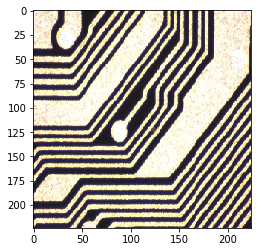

/home/hwehee/anaconda3/envs/cntk/lib/python3.5/site-packages/cntk/core.py:82: RuntimeWarning: data is not C contiguous; rearrange your data/computation to avoid costly data conversions
  RuntimeWarning)
/home/hwehee/anaconda3/envs/cntk/lib/python3.5/site-packages/ipykernel/__main__.py:52: DeprecationWarning: `imsave` is deprecated!
`imsave` is deprecated in SciPy 1.0.0, and will be removed in 1.2.0.
Use ``imageio.imwrite`` instead.


testfile name:  train_OK_8_쇼트_41_B_1.png
ground truth label:  OK
network prediction:  NG
(Parameter('b', [], [2]), Parameter('W', [], [512 x 1 x 1 x 2]))
iteration: 0 ,  1849.098773241043 (sec) elapsed
vector element-wise square:  51.0028484762
iteration: 1 ,  2998.957356452942 (sec) elapsed
vector element-wise square:  1057.3706131
         Current function value: -28.652595
         Iterations: 2
         Function evaluations: 25
         Gradient evaluations: 13
IF_val takes 455.86949586868286 sec
CG_logreg takes 8184.635362625122 sec, and its max/min value [0.0029054288658080735, -0.00167282699972677]

## SHOW 7-MOST DISADVANTAGEOUS EXAMPLES ##



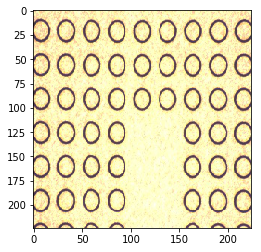

training set name:  train_NG_55_쇼트_2005_H_1.png
training set label:  NG
IF measure:  0.00290542886581
train_NG_55_쇼트_2005_H_1.png


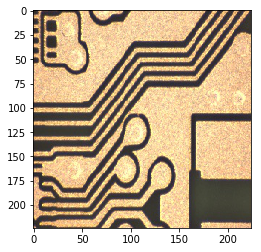

training set name:  train_NG_35_쇼트_593_F_1.png
training set label:  NG
IF measure:  0.00290210232487
train_NG_35_쇼트_593_F_1.png


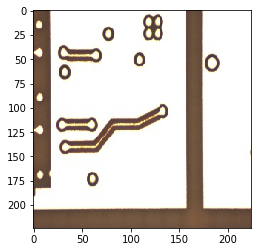

training set name:  train_NG_175_오픈_480_C_1.png
training set label:  NG
IF measure:  0.00289366269371
train_NG_175_오픈_480_C_1.png


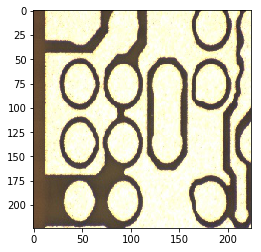

training set name:  train_NG_13_선간폭_1190_G_1.png
training set label:  NG
IF measure:  0.00289311974339
train_NG_13_선간폭_1190_G_1.png


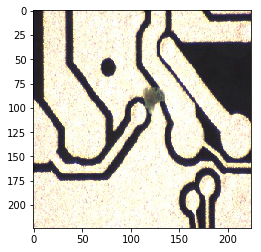

training set name:  train_NG_52_선간폭_898_H_1.png
training set label:  NG
IF measure:  0.00288674532857
train_NG_52_선간폭_898_H_1.png


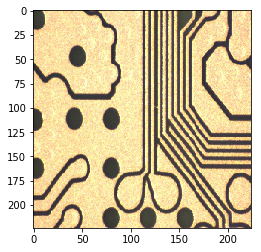

training set name:  train_NG_10_쇼트_730_G_1.png
training set label:  NG
IF measure:  0.00288042946541
train_NG_10_쇼트_730_G_1.png


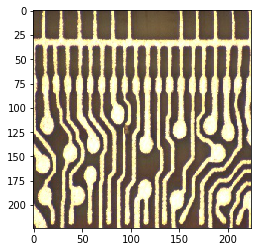

training set name:  train_NG_35_오픈_1371_I_1.png
training set label:  NG
IF measure:  0.0028735555289
train_NG_35_오픈_1371_I_1.png

## SHOW 7-MOST ADVANTAGEOUS EXAMPLES ##



/home/hwehee/anaconda3/envs/cntk/lib/python3.5/site-packages/ipykernel/__main__.py:62: DeprecationWarning: `imsave` is deprecated!
`imsave` is deprecated in SciPy 1.0.0, and will be removed in 1.2.0.
Use ``imageio.imwrite`` instead.


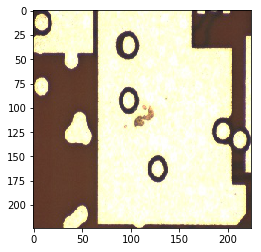

training set name:  train_OK_33_패드결함_4714_P_1.png
training set label:  OK
IF measure:  -0.00167282699973
train_OK_33_패드결함_4714_P_1.png


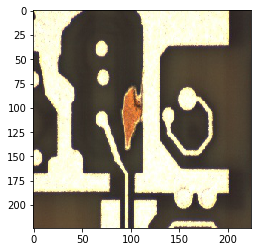

training set name:  train_OK_145_잔동_3026_J_1.png
training set label:  OK
IF measure:  -0.00165164126093
train_OK_145_잔동_3026_J_1.png


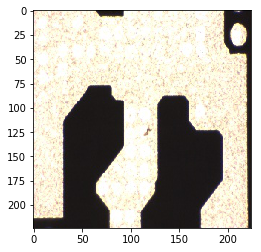

training set name:  train_OK_31_VH결함_7662_J_1.png
training set label:  OK
IF measure:  -0.00164908757256
train_OK_31_VH결함_7662_J_1.png


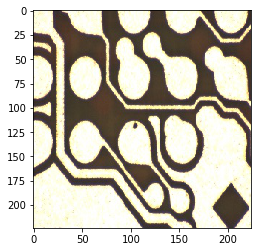

training set name:  train_OK_6_패드결함_432_D_1.png
training set label:  OK
IF measure:  -0.00164711390671
train_OK_6_패드결함_432_D_1.png


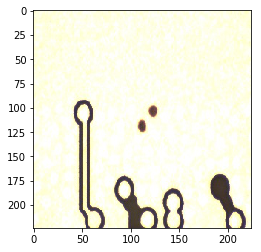

training set name:  train_OK_206_VH결함_1145_F_1.png
training set label:  OK
IF measure:  -0.00164234911953
train_OK_206_VH결함_1145_F_1.png


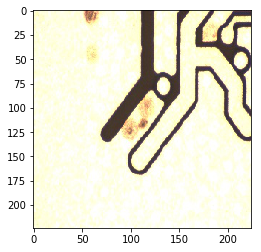

training set name:  train_OK_198_VH결함_1143_F_1.png
training set label:  OK
IF measure:  -0.0016368167505
train_OK_198_VH결함_1143_F_1.png


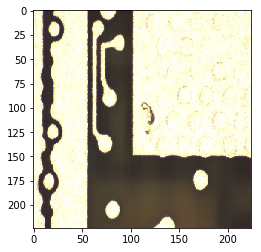

training set name:  train_OK_9_VH결함_2453_H_1.png
training set label:  OK
IF measure:  -0.0016285758323
train_OK_9_VH결함_2453_H_1.png

## SHOW 7-MOST INFLUENTIAL EXAMPLES ##



/home/hwehee/anaconda3/envs/cntk/lib/python3.5/site-packages/ipykernel/__main__.py:79: DeprecationWarning: `imsave` is deprecated!
`imsave` is deprecated in SciPy 1.0.0, and will be removed in 1.2.0.
Use ``imageio.imwrite`` instead.


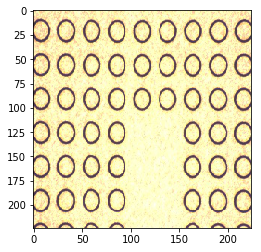

training set name:  train_NG_55_쇼트_2005_H_1.png
training set label:  NG
IF measure:  0.00290542886581


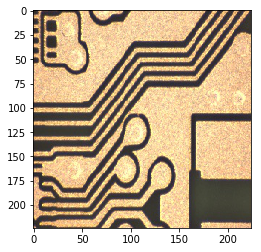

training set name:  train_NG_35_쇼트_593_F_1.png
training set label:  NG
IF measure:  0.00290210232487


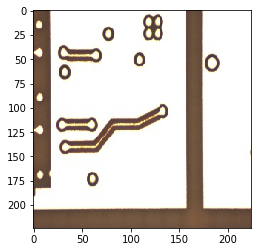

training set name:  train_NG_175_오픈_480_C_1.png
training set label:  NG
IF measure:  0.00289366269371


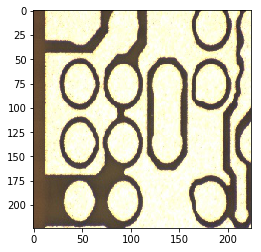

training set name:  train_NG_13_선간폭_1190_G_1.png
training set label:  NG
IF measure:  0.00289311974339


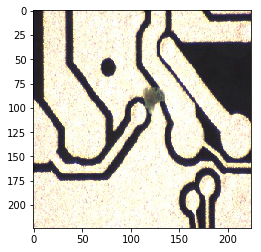

training set name:  train_NG_52_선간폭_898_H_1.png
training set label:  NG
IF measure:  0.00288674532857


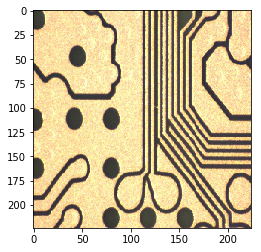

training set name:  train_NG_10_쇼트_730_G_1.png
training set label:  NG
IF measure:  0.00288042946541


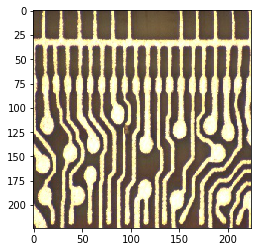

training set name:  train_NG_35_오픈_1371_I_1.png
training set label:  NG
IF measure:  0.0028735555289

## SHOW 7-MOST NEGLIGIBLE EXAMPLES ##



/home/hwehee/anaconda3/envs/cntk/lib/python3.5/site-packages/ipykernel/__main__.py:105: DeprecationWarning: `imsave` is deprecated!
`imsave` is deprecated in SciPy 1.0.0, and will be removed in 1.2.0.
Use ``imageio.imwrite`` instead.


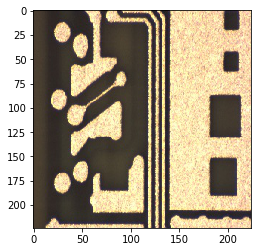

training set name:  train_OK_169_결손_1532_E_1.png
training set label:  OK
IF measure:  -0.000151640860543


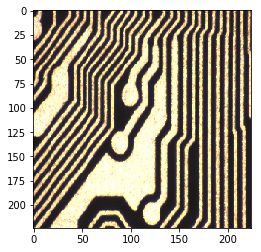

training set name:  train_OK_757_선간폭_551_C_1.png
training set label:  OK
IF measure:  -0.000152422060043


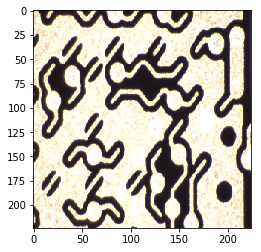

training set name:  train_OK_10_쇼트_9_A_1.png
training set label:  OK
IF measure:  -0.000153354560013


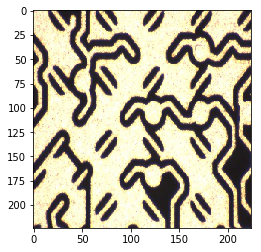

training set name:  train_OK_509_선간폭_257_A_1.png
training set label:  OK
IF measure:  -0.000155856990654


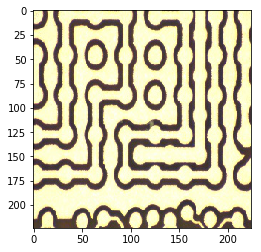

training set name:  train_OK_108_쇼트_464_D_1.png
training set label:  OK
IF measure:  -0.000156780593144


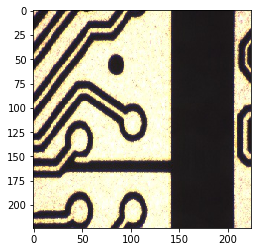

training set name:  train_OK_469_선간폭_228_A_1.png
training set label:  OK
IF measure:  -0.000157958026951


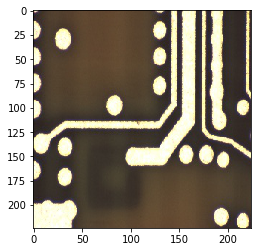

training set name:  train_OK_37_결손_2720_J_1.png
training set label:  OK
IF measure:  -0.000157977626143


/home/hwehee/anaconda3/envs/cntk/lib/python3.5/site-packages/ipykernel/__main__.py:120: DeprecationWarning: `imsave` is deprecated!
`imsave` is deprecated in SciPy 1.0.0, and will be removed in 1.2.0.
Use ``imageio.imwrite`` instead.


IF_val takes 451.8224482536316 sec
V_logreg takes 451.8226783275604 sec, and its max/min value [0.001060070002975688, -0.00063099237060537639]

## SHOW 7-MOST DISADVANTAGEOUS EXAMPLES ##



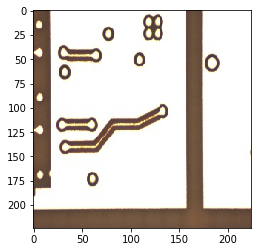

training set name:  train_NG_175_오픈_480_C_1.png
training set label:  NG
IF measure:  0.00106007000298
train_NG_175_오픈_480_C_1.png


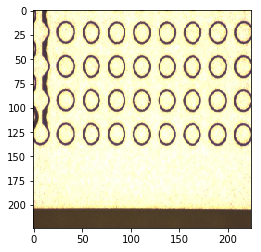

training set name:  train_NG_16_쇼트_449_B_1.png
training set label:  NG
IF measure:  0.00105541213474
train_NG_16_쇼트_449_B_1.png


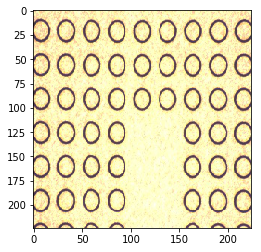

training set name:  train_NG_55_쇼트_2005_H_1.png
training set label:  NG
IF measure:  0.00105538978709
train_NG_55_쇼트_2005_H_1.png


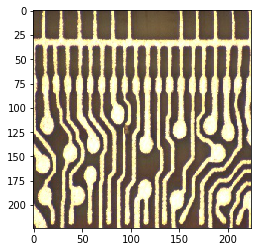

training set name:  train_NG_35_오픈_1371_I_1.png
training set label:  NG
IF measure:  0.00105287172811
train_NG_35_오픈_1371_I_1.png


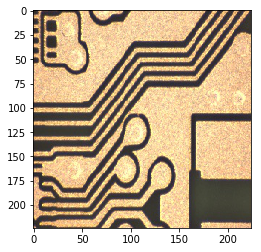

training set name:  train_NG_35_쇼트_593_F_1.png
training set label:  NG
IF measure:  0.00105194891488
train_NG_35_쇼트_593_F_1.png


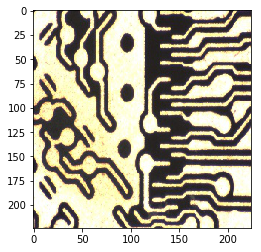

training set name:  train_NG_36_쇼트_1114_G_1.png
training set label:  NG
IF measure:  0.0010503904439
train_NG_36_쇼트_1114_G_1.png


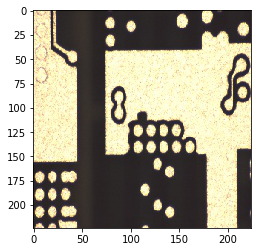

training set name:  train_NG_3_핀홀_112_B_1.png
training set label:  NG
IF measure:  0.00104985463351
train_NG_3_핀홀_112_B_1.png

## SHOW 7-MOST ADVANTAGEOUS EXAMPLES ##



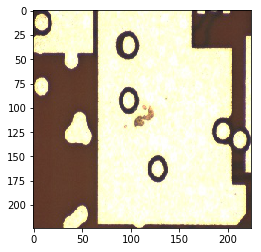

training set name:  train_OK_33_패드결함_4714_P_1.png
training set label:  OK
IF measure:  -0.000630992370605
train_OK_33_패드결함_4714_P_1.png


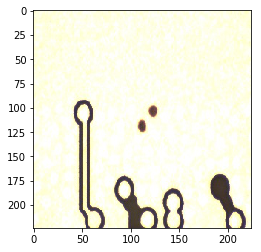

training set name:  train_OK_206_VH결함_1145_F_1.png
training set label:  OK
IF measure:  -0.000630768326211
train_OK_206_VH결함_1145_F_1.png


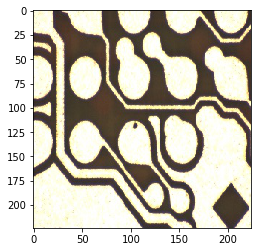

training set name:  train_OK_6_패드결함_432_D_1.png
training set label:  OK
IF measure:  -0.000625155684472
train_OK_6_패드결함_432_D_1.png


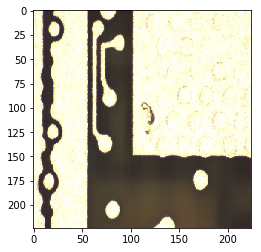

training set name:  train_OK_9_VH결함_2453_H_1.png
training set label:  OK
IF measure:  -0.000619333398029
train_OK_9_VH결함_2453_H_1.png


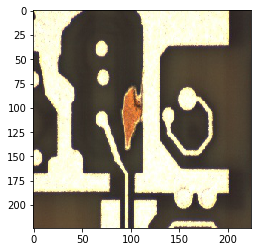

training set name:  train_OK_145_잔동_3026_J_1.png
training set label:  OK
IF measure:  -0.000618570962741
train_OK_145_잔동_3026_J_1.png


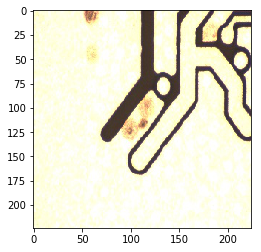

training set name:  train_OK_198_VH결함_1143_F_1.png
training set label:  OK
IF measure:  -0.000616870326512
train_OK_198_VH결함_1143_F_1.png


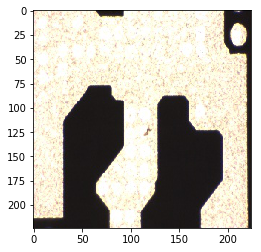

training set name:  train_OK_31_VH결함_7662_J_1.png
training set label:  OK
IF measure:  -0.000615885634699
train_OK_31_VH결함_7662_J_1.png

## SHOW 7-MOST INFLUENTIAL EXAMPLES ##



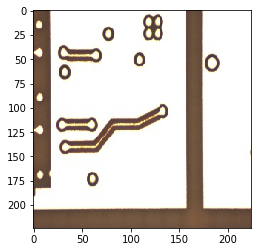

training set name:  train_NG_175_오픈_480_C_1.png
training set label:  NG
IF measure:  0.00106007000298


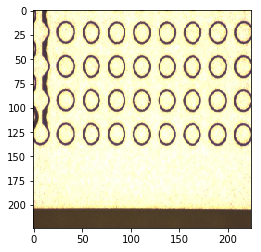

training set name:  train_NG_16_쇼트_449_B_1.png
training set label:  NG
IF measure:  0.00105541213474


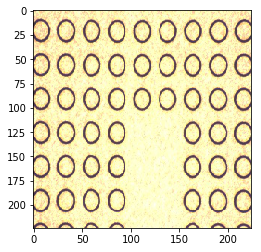

training set name:  train_NG_55_쇼트_2005_H_1.png
training set label:  NG
IF measure:  0.00105538978709


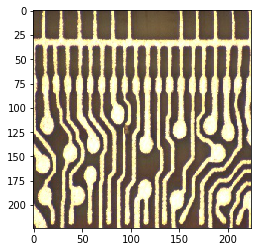

training set name:  train_NG_35_오픈_1371_I_1.png
training set label:  NG
IF measure:  0.00105287172811


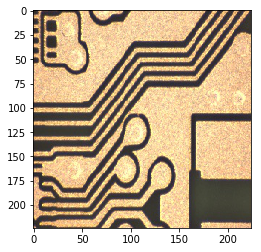

training set name:  train_NG_35_쇼트_593_F_1.png
training set label:  NG
IF measure:  0.00105194891488


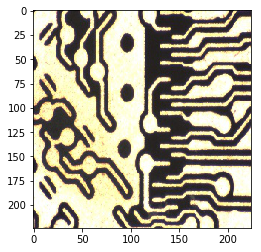

training set name:  train_NG_36_쇼트_1114_G_1.png
training set label:  NG
IF measure:  0.0010503904439


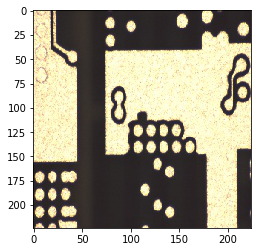

training set name:  train_NG_3_핀홀_112_B_1.png
training set label:  NG
IF measure:  0.00104985463351

## SHOW 7-MOST NEGLIGIBLE EXAMPLES ##



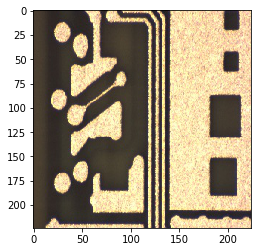

training set name:  train_OK_169_결손_1532_E_1.png
training set label:  OK
IF measure:  -5.55871998215e-05


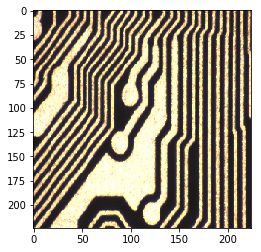

training set name:  train_OK_757_선간폭_551_C_1.png
training set label:  OK
IF measure:  -5.59714271267e-05


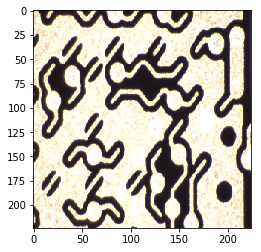

training set name:  train_OK_10_쇼트_9_A_1.png
training set label:  OK
IF measure:  -5.68901518363e-05


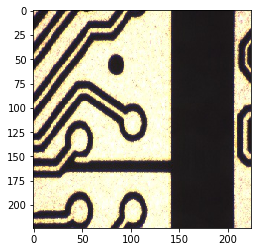

training set name:  train_OK_469_선간폭_228_A_1.png
training set label:  OK
IF measure:  -5.70887860403e-05


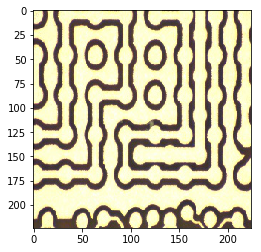

training set name:  train_OK_108_쇼트_464_D_1.png
training set label:  OK
IF measure:  -5.72360245209e-05


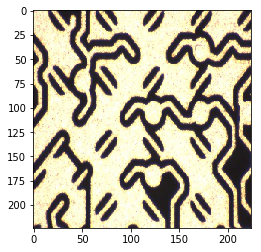

training set name:  train_OK_509_선간폭_257_A_1.png
training set label:  OK
IF measure:  -5.74540245677e-05


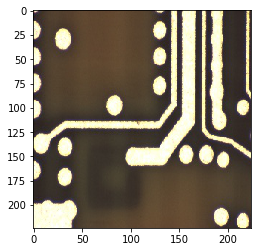

training set name:  train_OK_37_결손_2720_J_1.png
training set label:  OK
IF measure:  -5.83987922603e-05
IF_val takes 1903.5602180957794 sec
V takes 1903.5646765232086 sec, and its max/min value [0.0016489444871420195, -0.00087711970766149938]

## SHOW 7-MOST DISADVANTAGEOUS EXAMPLES ##



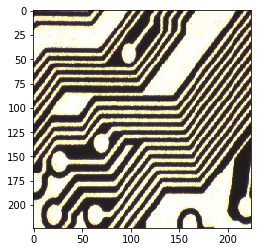

training set name:  train_NG_129_선간폭_825_F_1.png
training set label:  NG
IF measure:  0.00164894448714
train_NG_129_선간폭_825_F_1.png


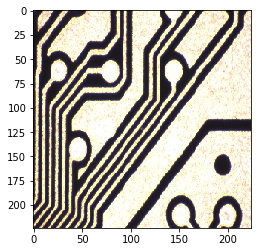

training set name:  train_NG_40_선간폭_342_D_1.png
training set label:  NG
IF measure:  0.00157380398352
train_NG_40_선간폭_342_D_1.png


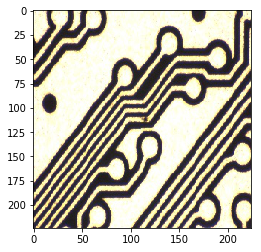

training set name:  train_NG_59_결손_1074_H_1.png
training set label:  NG
IF measure:  0.00156299442239
train_NG_59_결손_1074_H_1.png


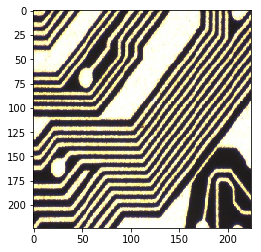

training set name:  train_NG_145_결손_1026_G_1.png
training set label:  NG
IF measure:  0.00153492422662
train_NG_145_결손_1026_G_1.png


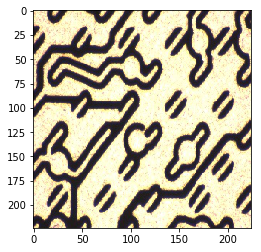

training set name:  train_NG_64_쇼트_363_D_1.png
training set label:  NG
IF measure:  0.00152216433652
train_NG_64_쇼트_363_D_1.png


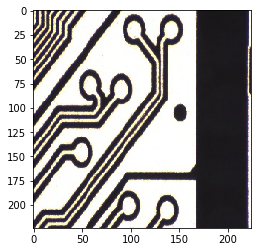

training set name:  train_NG_3_선간폭_397_C_1.png
training set label:  NG
IF measure:  0.00151847397127
train_NG_3_선간폭_397_C_1.png


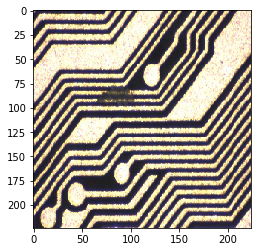

training set name:  train_NG_4_오픈_7_A_1.png
training set label:  NG
IF measure:  0.00151383643429
train_NG_4_오픈_7_A_1.png

## SHOW 7-MOST ADVANTAGEOUS EXAMPLES ##



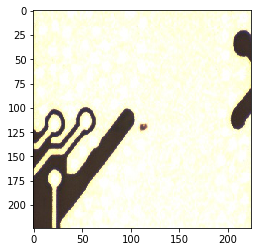

training set name:  train_OK_333_VH결함_3654_N_1.png
training set label:  OK
IF measure:  -0.000877119707661
train_OK_333_VH결함_3654_N_1.png


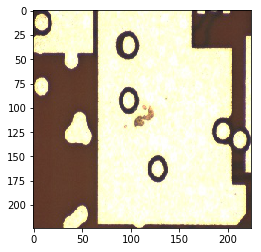

training set name:  train_OK_33_패드결함_4714_P_1.png
training set label:  OK
IF measure:  -0.000861178335969
train_OK_33_패드결함_4714_P_1.png


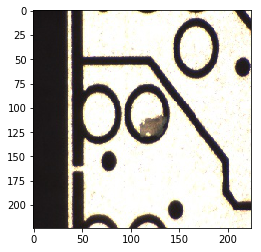

training set name:  train_OK_102_선간폭_958_H_1.png
training set label:  OK
IF measure:  -0.000853105856922
train_OK_102_선간폭_958_H_1.png


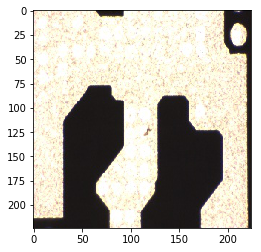

training set name:  train_OK_31_VH결함_7662_J_1.png
training set label:  OK
IF measure:  -0.000849624283453
train_OK_31_VH결함_7662_J_1.png


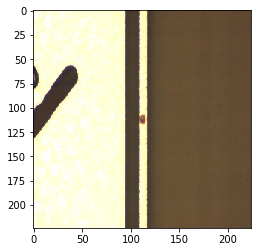

training set name:  train_OK_417_결손_-1_-1_1.png
training set label:  OK
IF measure:  -0.00084790361983
train_OK_417_결손_-1_-1_1.png


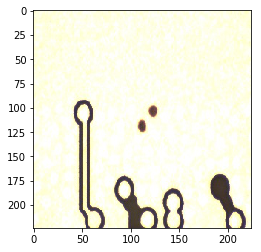

training set name:  train_OK_206_VH결함_1145_F_1.png
training set label:  OK
IF measure:  -0.000847511390856
train_OK_206_VH결함_1145_F_1.png


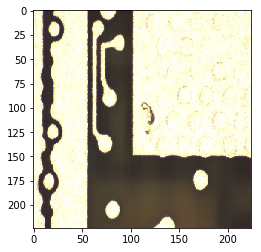

training set name:  train_OK_9_VH결함_2453_H_1.png
training set label:  OK
IF measure:  -0.000836473561269
train_OK_9_VH결함_2453_H_1.png

## SHOW 7-MOST INFLUENTIAL EXAMPLES ##



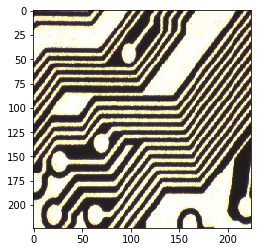

training set name:  train_NG_129_선간폭_825_F_1.png
training set label:  NG
IF measure:  0.00164894448714


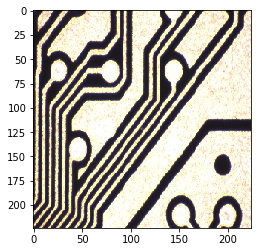

training set name:  train_NG_40_선간폭_342_D_1.png
training set label:  NG
IF measure:  0.00157380398352


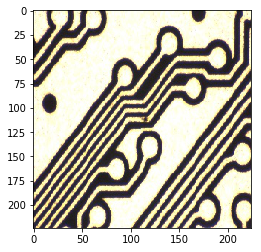

training set name:  train_NG_59_결손_1074_H_1.png
training set label:  NG
IF measure:  0.00156299442239


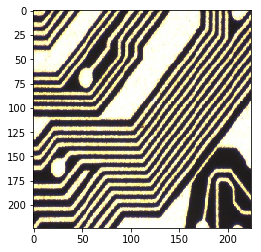

training set name:  train_NG_145_결손_1026_G_1.png
training set label:  NG
IF measure:  0.00153492422662


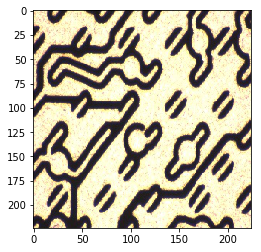

training set name:  train_NG_64_쇼트_363_D_1.png
training set label:  NG
IF measure:  0.00152216433652


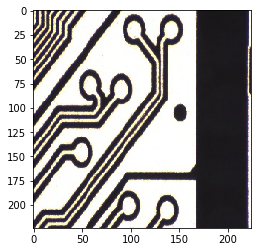

training set name:  train_NG_3_선간폭_397_C_1.png
training set label:  NG
IF measure:  0.00151847397127


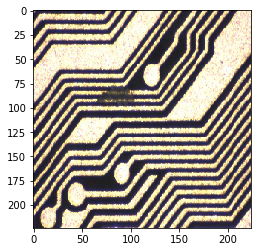

training set name:  train_NG_4_오픈_7_A_1.png
training set label:  NG
IF measure:  0.00151383643429

## SHOW 7-MOST NEGLIGIBLE EXAMPLES ##



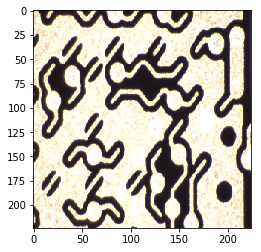

training set name:  train_OK_10_쇼트_9_A_1.png
training set label:  OK
IF measure:  -6.36130517172e-05


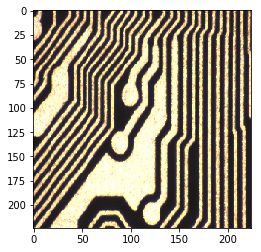

training set name:  train_OK_757_선간폭_551_C_1.png
training set label:  OK
IF measure:  -6.43501115504e-05


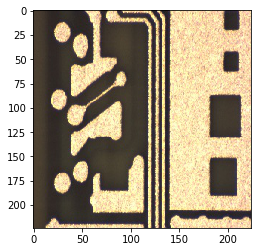

training set name:  train_OK_169_결손_1532_E_1.png
training set label:  OK
IF measure:  -6.54148052163e-05


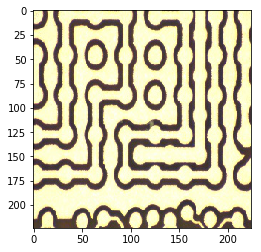

training set name:  train_OK_108_쇼트_464_D_1.png
training set label:  OK
IF measure:  -6.54584081094e-05


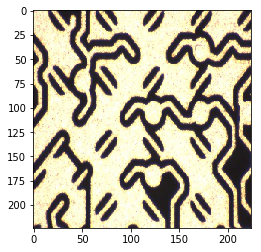

training set name:  train_OK_509_선간폭_257_A_1.png
training set label:  OK
IF measure:  -6.65278171408e-05


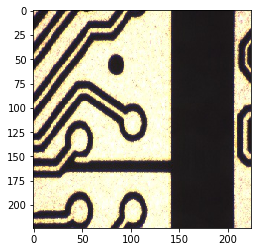

training set name:  train_OK_469_선간폭_228_A_1.png
training set label:  OK
IF measure:  -6.70722977391e-05


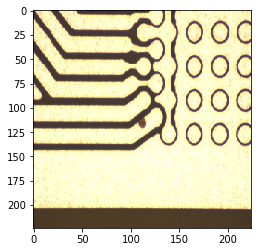

training set name:  train_OK_40_결손_1459_E_1.png
training set label:  OK
IF measure:  -6.7894847897e-05
IF_val takes 456.55988907814026 sec
V_cos takes 456.56010031700134 sec, and its max/min value [6.9919511484775615e-05, -6.9928473092109567e-05]

## SHOW 7-MOST DISADVANTAGEOUS EXAMPLES ##



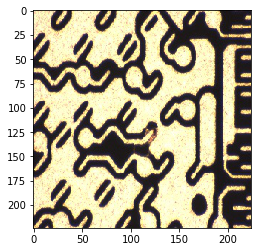

training set name:  train_NG_70_쇼트_948_G_1.png
training set label:  NG
IF measure:  6.99195114848e-05
train_NG_70_쇼트_948_G_1.png


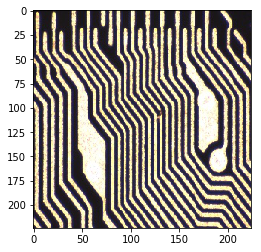

training set name:  train_NG_48_쇼트_1086_H_1.png
training set label:  NG
IF measure:  6.99176065492e-05
train_NG_48_쇼트_1086_H_1.png


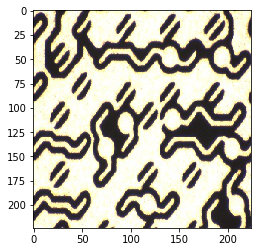

training set name:  train_NG_29_쇼트_1069_H_1.png
training set label:  NG
IF measure:  6.99154659781e-05
train_NG_29_쇼트_1069_H_1.png


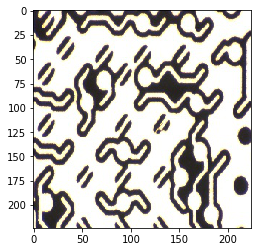

training set name:  train_NG_123_선간폭_1089_H_1.png
training set label:  NG
IF measure:  6.99148318618e-05
train_NG_123_선간폭_1089_H_1.png


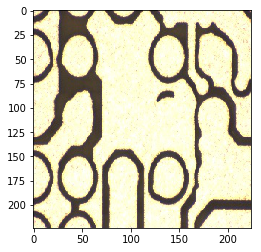

training set name:  train_NG_53_쇼트_1454_L_1.png
training set label:  NG
IF measure:  6.9914576555e-05
train_NG_53_쇼트_1454_L_1.png


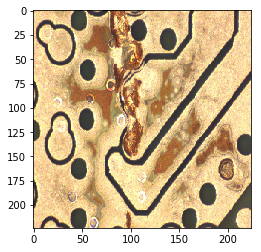

training set name:  train_NG_177_패드결함_639_F_1.png
training set label:  NG
IF measure:  6.99133647498e-05
train_NG_177_패드결함_639_F_1.png


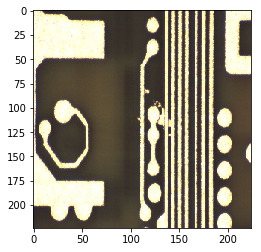

training set name:  train_NG_83_돌기_1420_F_1.png
training set label:  NG
IF measure:  6.99111524714e-05
train_NG_83_돌기_1420_F_1.png

## SHOW 7-MOST ADVANTAGEOUS EXAMPLES ##



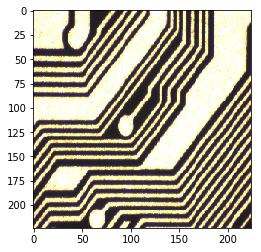

training set name:  train_OK_34_오픈_937_H_1.png
training set label:  OK
IF measure:  -6.99284730921e-05
train_OK_34_오픈_937_H_1.png


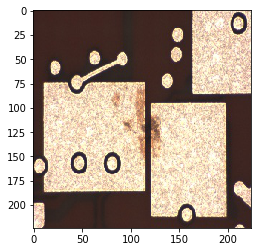

training set name:  train_OK_98_선간폭_4989_K_1.png
training set label:  OK
IF measure:  -6.99241606081e-05
train_OK_98_선간폭_4989_K_1.png


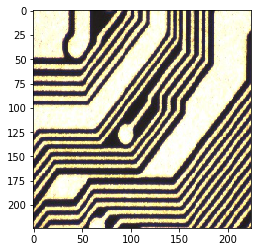

training set name:  train_OK_33_선간폭_937_H_1.png
training set label:  OK
IF measure:  -6.99204067432e-05
train_OK_33_선간폭_937_H_1.png


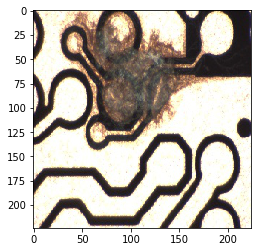

training set name:  train_OK_210_오픈_373_C_1.png
training set label:  OK
IF measure:  -6.99104902016e-05
train_OK_210_오픈_373_C_1.png


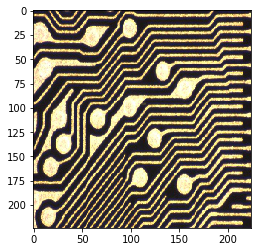

training set name:  train_OK_160_선간폭_461_C_1.png
training set label:  OK
IF measure:  -6.99098878482e-05
train_OK_160_선간폭_461_C_1.png


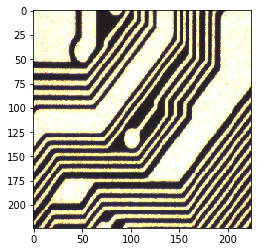

training set name:  train_OK_35_오픈_937_H_1.png
training set label:  OK
IF measure:  -6.99088730577e-05
train_OK_35_오픈_937_H_1.png


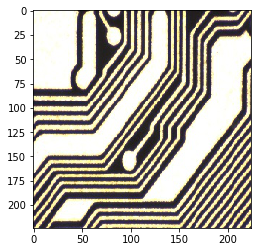

training set name:  train_OK_220_오픈_819_E_1.png
training set label:  OK
IF measure:  -6.99080119084e-05
train_OK_220_오픈_819_E_1.png

## SHOW 7-MOST INFLUENTIAL EXAMPLES ##



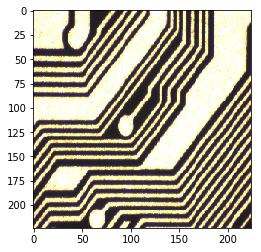

training set name:  train_OK_34_오픈_937_H_1.png
training set label:  OK
IF measure:  -6.99284730921e-05


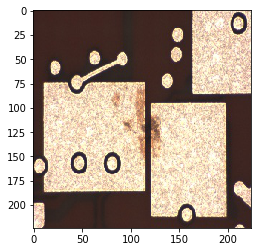

training set name:  train_OK_98_선간폭_4989_K_1.png
training set label:  OK
IF measure:  -6.99241606081e-05


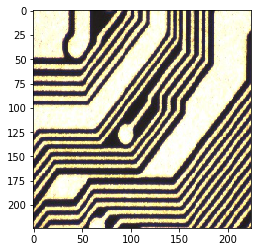

training set name:  train_OK_33_선간폭_937_H_1.png
training set label:  OK
IF measure:  -6.99204067432e-05


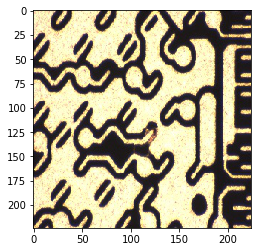

training set name:  train_NG_70_쇼트_948_G_1.png
training set label:  NG
IF measure:  6.99195114848e-05


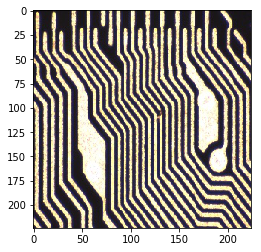

training set name:  train_NG_48_쇼트_1086_H_1.png
training set label:  NG
IF measure:  6.99176065492e-05


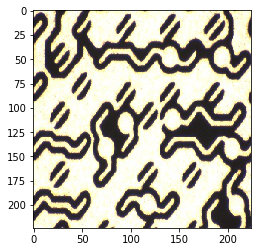

training set name:  train_NG_29_쇼트_1069_H_1.png
training set label:  NG
IF measure:  6.99154659781e-05


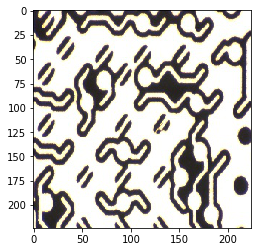

training set name:  train_NG_123_선간폭_1089_H_1.png
training set label:  NG
IF measure:  6.99148318618e-05

## SHOW 7-MOST NEGLIGIBLE EXAMPLES ##



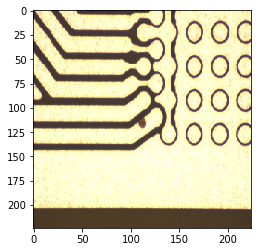

training set name:  train_OK_40_결손_1459_E_1.png
training set label:  OK
IF measure:  -6.95877745822e-05


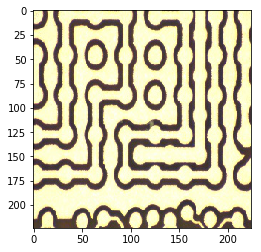

training set name:  train_OK_108_쇼트_464_D_1.png
training set label:  OK
IF measure:  -6.96019434507e-05


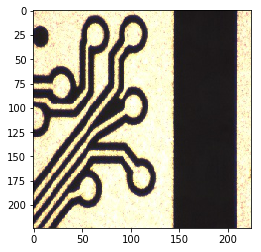

training set name:  train_OK_128_선간폭_181_B_1.png
training set label:  OK
IF measure:  -6.96064940366e-05


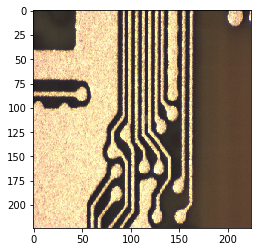

training set name:  train_OK_172_쇼트_1380_E_1.png
training set label:  OK
IF measure:  -6.960857421e-05


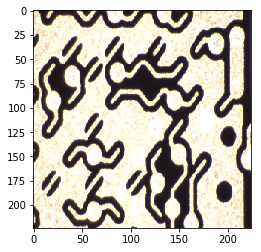

training set name:  train_OK_10_쇼트_9_A_1.png
training set label:  OK
IF measure:  -6.96115276241e-05


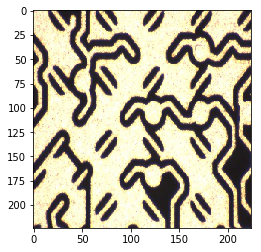

training set name:  train_OK_509_선간폭_257_A_1.png
training set label:  OK
IF measure:  -6.96149305324e-05


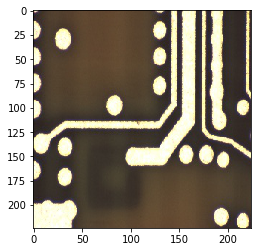

training set name:  train_OK_37_결손_2720_J_1.png
training set label:  OK
IF measure:  -6.96154727887e-05
Recursion depth: 0, norm: 4248.0075311109085, time: 193.10393857955933 

Recursion depth: 1, norm: 7984.754187669148, time: 191.95946550369263 

Recursion depth: 2, norm: 11285.269037555108, time: 191.97261762619019 

Recursion depth: 3, norm: 14201.188057694328, time: 192.01373052597046 

Recursion depth: 4, norm: 16777.21607567835, time: 192.75835704803467 

Recursion depth: 5, norm: 19053.3021350631, time: 192.42027592658997 

Recursion depth: 6, norm: 21063.761012696665, time: 192.49504399299622 

Recursion depth: 7, norm: 22840.23852217835, time: 192.68442463874817 

Recursion depth: 8, norm: 24409.65191271682, time: 192.48119235038757 

Recursion depth: 9, norm: 25796.190968823284, time: 192.5091679096222 

Recursion depth: 10, norm: 27020.643469392064, time: 192.5691225528717 

Recursion depth: 11, norm: 28102.699087454217, time: 192.454252243042 

Recursion depth: 12, norm: 2

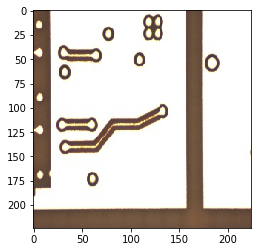

training set name:  train_NG_175_오픈_480_C_1.png
training set label:  NG
IF measure:  0.00885432029777
train_NG_175_오픈_480_C_1.png


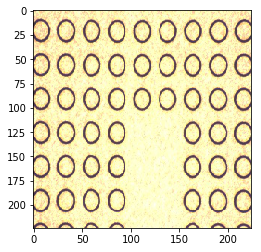

training set name:  train_NG_55_쇼트_2005_H_1.png
training set label:  NG
IF measure:  0.00881585525657
train_NG_55_쇼트_2005_H_1.png


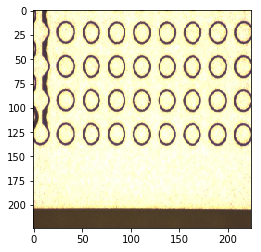

training set name:  train_NG_16_쇼트_449_B_1.png
training set label:  NG
IF measure:  0.0088153980547
train_NG_16_쇼트_449_B_1.png


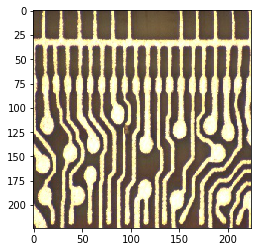

training set name:  train_NG_35_오픈_1371_I_1.png
training set label:  NG
IF measure:  0.00879491717263
train_NG_35_오픈_1371_I_1.png


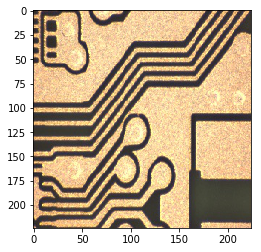

training set name:  train_NG_35_쇼트_593_F_1.png
training set label:  NG
IF measure:  0.00878724545828
train_NG_35_쇼트_593_F_1.png


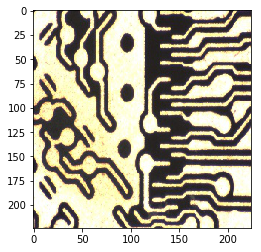

training set name:  train_NG_36_쇼트_1114_G_1.png
training set label:  NG
IF measure:  0.00877418964057
train_NG_36_쇼트_1114_G_1.png


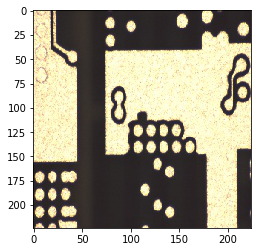

training set name:  train_NG_3_핀홀_112_B_1.png
training set label:  NG
IF measure:  0.00876942333262
train_NG_3_핀홀_112_B_1.png

## SHOW 7-MOST ADVANTAGEOUS EXAMPLES ##



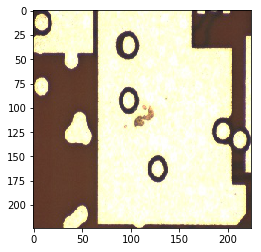

training set name:  train_OK_33_패드결함_4714_P_1.png
training set label:  OK
IF measure:  -0.00527754308672
train_OK_33_패드결함_4714_P_1.png


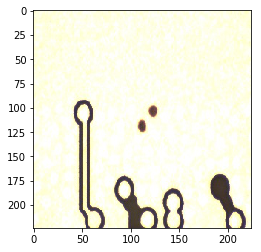

training set name:  train_OK_206_VH결함_1145_F_1.png
training set label:  OK
IF measure:  -0.00527507175876
train_OK_206_VH결함_1145_F_1.png


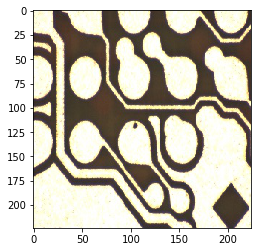

training set name:  train_OK_6_패드결함_432_D_1.png
training set label:  OK
IF measure:  -0.00522821299063
train_OK_6_패드결함_432_D_1.png


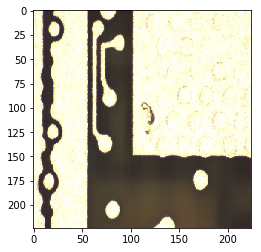

training set name:  train_OK_9_VH결함_2453_H_1.png
training set label:  OK
IF measure:  -0.00517945616405
train_OK_9_VH결함_2453_H_1.png


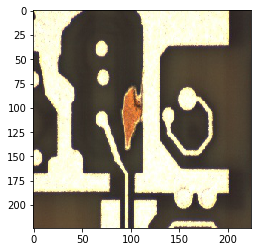

training set name:  train_OK_145_잔동_3026_J_1.png
training set label:  OK
IF measure:  -0.00517333646509
train_OK_145_잔동_3026_J_1.png


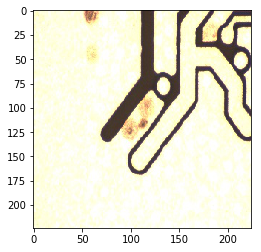

training set name:  train_OK_198_VH결함_1143_F_1.png
training set label:  OK
IF measure:  -0.00515887662044
train_OK_198_VH결함_1143_F_1.png


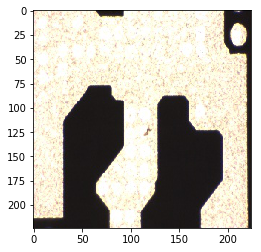

training set name:  train_OK_31_VH결함_7662_J_1.png
training set label:  OK
IF measure:  -0.00515100761381
train_OK_31_VH결함_7662_J_1.png

## SHOW 7-MOST INFLUENTIAL EXAMPLES ##



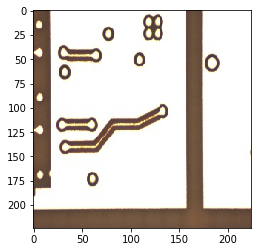

training set name:  train_NG_175_오픈_480_C_1.png
training set label:  NG
IF measure:  0.00885432029777


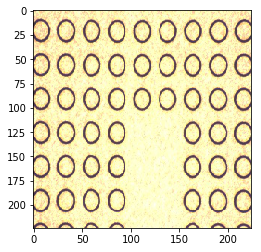

training set name:  train_NG_55_쇼트_2005_H_1.png
training set label:  NG
IF measure:  0.00881585525657


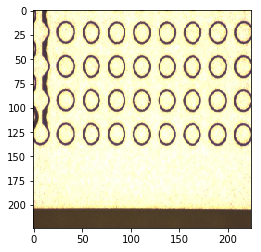

training set name:  train_NG_16_쇼트_449_B_1.png
training set label:  NG
IF measure:  0.0088153980547


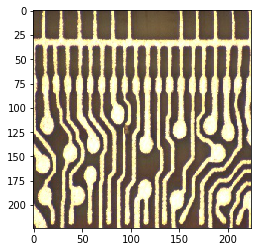

training set name:  train_NG_35_오픈_1371_I_1.png
training set label:  NG
IF measure:  0.00879491717263


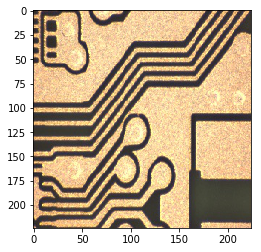

training set name:  train_NG_35_쇼트_593_F_1.png
training set label:  NG
IF measure:  0.00878724545828


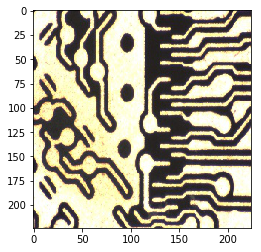

training set name:  train_NG_36_쇼트_1114_G_1.png
training set label:  NG
IF measure:  0.00877418964057


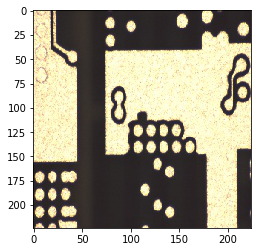

training set name:  train_NG_3_핀홀_112_B_1.png
training set label:  NG
IF measure:  0.00876942333262

## SHOW 7-MOST NEGLIGIBLE EXAMPLES ##



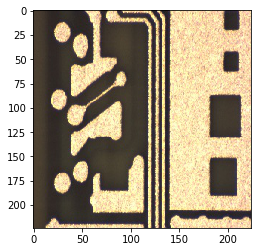

training set name:  train_OK_169_결손_1532_E_1.png
training set label:  OK
IF measure:  -0.000464264549007


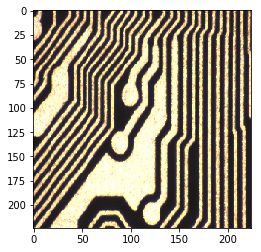

training set name:  train_OK_757_선간폭_551_C_1.png
training set label:  OK
IF measure:  -0.000467482054433


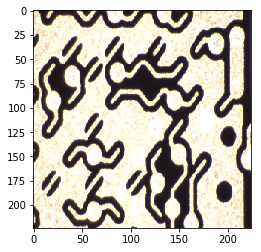

training set name:  train_OK_10_쇼트_9_A_1.png
training set label:  OK
IF measure:  -0.00047514539876


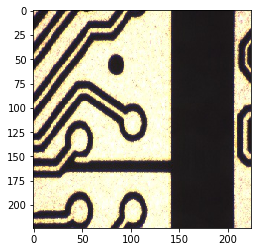

training set name:  train_OK_469_선간폭_228_A_1.png
training set label:  OK
IF measure:  -0.000476862481466


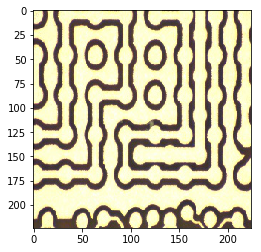

training set name:  train_OK_108_쇼트_464_D_1.png
training set label:  OK
IF measure:  -0.000478063565687


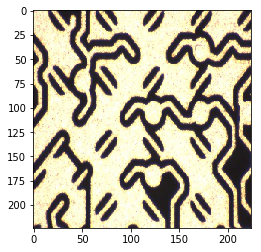

training set name:  train_OK_509_선간폭_257_A_1.png
training set label:  OK
IF measure:  -0.000479845928983


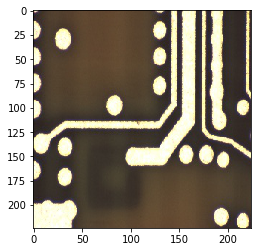

training set name:  train_OK_37_결손_2720_J_1.png
training set label:  OK
IF measure:  -0.000487748888294


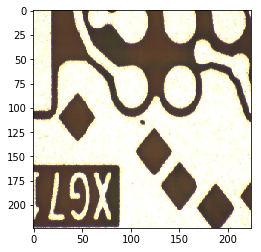

testfile name:  train_OK_8_패드결함_723_D_1.png
ground truth label:  OK
network prediction:  NG
(Parameter('b', [], [2]), Parameter('W', [], [512 x 1 x 1 x 2]))


/home/hwehee/anaconda3/envs/cntk/lib/python3.5/site-packages/cntk/core.py:82: RuntimeWarning: data is not C contiguous; rearrange your data/computation to avoid costly data conversions
  RuntimeWarning)
/home/hwehee/anaconda3/envs/cntk/lib/python3.5/site-packages/ipykernel/__main__.py:52: DeprecationWarning: `imsave` is deprecated!
`imsave` is deprecated in SciPy 1.0.0, and will be removed in 1.2.0.
Use ``imageio.imwrite`` instead.


iteration: 0 ,  1541.650136232376 (sec) elapsed
vector element-wise square:  65.4138465673
iteration: 1 ,  2716.585897922516 (sec) elapsed
vector element-wise square:  1048.83182907
iteration: 2 ,  3499.925034761429 (sec) elapsed
vector element-wise square:  1262.08573341
iteration: 3 ,  4671.436281204224 (sec) elapsed
vector element-wise square:  3603.21514893
iteration: 4 ,  6225.210421562195 (sec) elapsed
vector element-wise square:  4513.15049744
         Current function value: -39.587141
         Iterations: 5
         Function evaluations: 34
         Gradient evaluations: 25
IF_val takes 450.8319010734558 sec
CG_logreg takes 11879.49299120903 sec, and its max/min value [0.0040087364011235438, -0.0022512444598812684]

## SHOW 7-MOST DISADVANTAGEOUS EXAMPLES ##



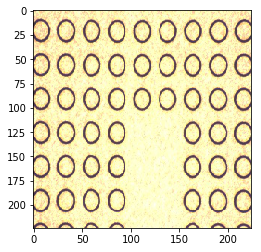

training set name:  train_NG_55_쇼트_2005_H_1.png
training set label:  NG
IF measure:  0.00400873640112
train_NG_55_쇼트_2005_H_1.png


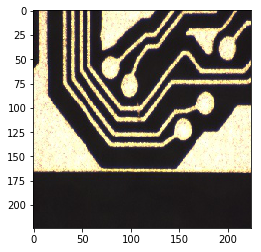

training set name:  train_NG_93_선간폭_356_D_1.png
training set label:  NG
IF measure:  0.00400303797917
train_NG_93_선간폭_356_D_1.png


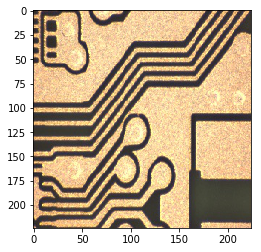

training set name:  train_NG_35_쇼트_593_F_1.png
training set label:  NG
IF measure:  0.00399584037614
train_NG_35_쇼트_593_F_1.png


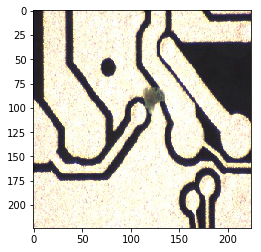

training set name:  train_NG_52_선간폭_898_H_1.png
training set label:  NG
IF measure:  0.00399476645687
train_NG_52_선간폭_898_H_1.png


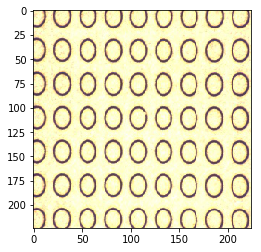

training set name:  train_NG_52_쇼트_1708_H_1.png
training set label:  NG
IF measure:  0.00399185984925
train_NG_52_쇼트_1708_H_1.png


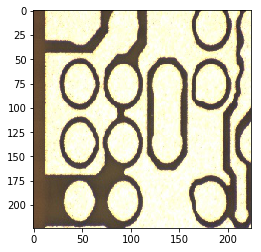

training set name:  train_NG_13_선간폭_1190_G_1.png
training set label:  NG
IF measure:  0.00398863374858
train_NG_13_선간폭_1190_G_1.png


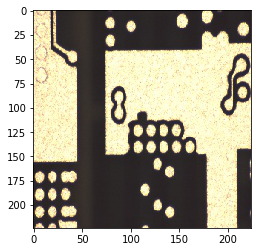

training set name:  train_NG_3_핀홀_112_B_1.png
training set label:  NG
IF measure:  0.00398747454286
train_NG_3_핀홀_112_B_1.png

## SHOW 7-MOST ADVANTAGEOUS EXAMPLES ##



/home/hwehee/anaconda3/envs/cntk/lib/python3.5/site-packages/ipykernel/__main__.py:62: DeprecationWarning: `imsave` is deprecated!
`imsave` is deprecated in SciPy 1.0.0, and will be removed in 1.2.0.
Use ``imageio.imwrite`` instead.


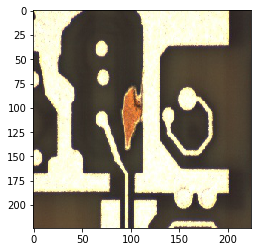

training set name:  train_OK_145_잔동_3026_J_1.png
training set label:  OK
IF measure:  -0.00225124445988
train_OK_145_잔동_3026_J_1.png


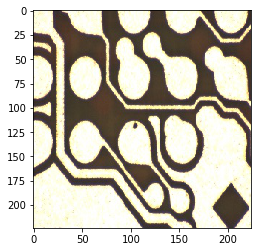

training set name:  train_OK_6_패드결함_432_D_1.png
training set label:  OK
IF measure:  -0.00224488709311
train_OK_6_패드결함_432_D_1.png


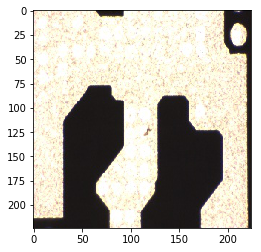

training set name:  train_OK_31_VH결함_7662_J_1.png
training set label:  OK
IF measure:  -0.00223094360644
train_OK_31_VH결함_7662_J_1.png


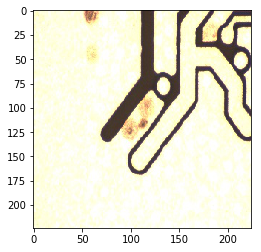

training set name:  train_OK_198_VH결함_1143_F_1.png
training set label:  OK
IF measure:  -0.002229159244
train_OK_198_VH결함_1143_F_1.png


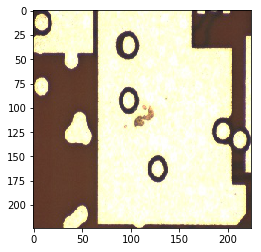

training set name:  train_OK_33_패드결함_4714_P_1.png
training set label:  OK
IF measure:  -0.00221322321466
train_OK_33_패드결함_4714_P_1.png


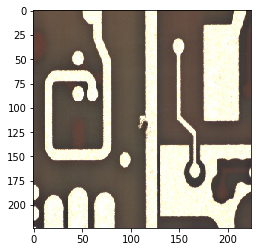

training set name:  train_OK_7_잔동_1965_N_1.png
training set label:  OK
IF measure:  -0.00220988650957
train_OK_7_잔동_1965_N_1.png


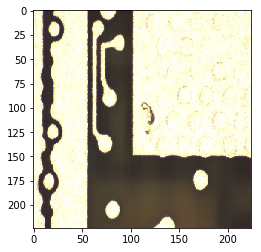

training set name:  train_OK_9_VH결함_2453_H_1.png
training set label:  OK
IF measure:  -0.002193551599
train_OK_9_VH결함_2453_H_1.png

## SHOW 7-MOST INFLUENTIAL EXAMPLES ##



/home/hwehee/anaconda3/envs/cntk/lib/python3.5/site-packages/ipykernel/__main__.py:79: DeprecationWarning: `imsave` is deprecated!
`imsave` is deprecated in SciPy 1.0.0, and will be removed in 1.2.0.
Use ``imageio.imwrite`` instead.


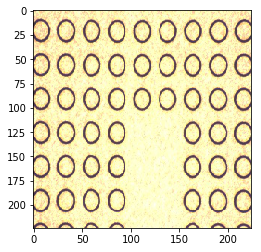

training set name:  train_NG_55_쇼트_2005_H_1.png
training set label:  NG
IF measure:  0.00400873640112


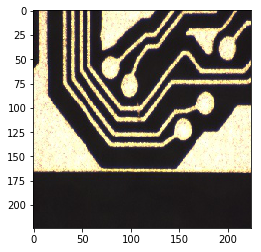

training set name:  train_NG_93_선간폭_356_D_1.png
training set label:  NG
IF measure:  0.00400303797917


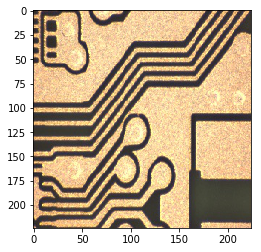

training set name:  train_NG_35_쇼트_593_F_1.png
training set label:  NG
IF measure:  0.00399584037614


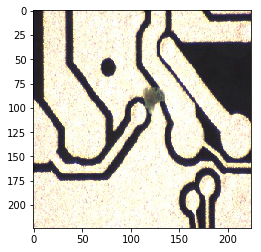

training set name:  train_NG_52_선간폭_898_H_1.png
training set label:  NG
IF measure:  0.00399476645687


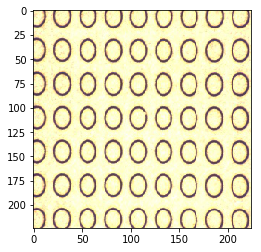

training set name:  train_NG_52_쇼트_1708_H_1.png
training set label:  NG
IF measure:  0.00399185984925


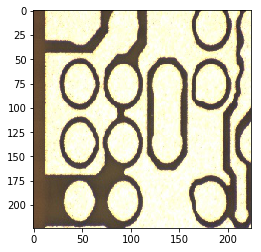

training set name:  train_NG_13_선간폭_1190_G_1.png
training set label:  NG
IF measure:  0.00398863374858


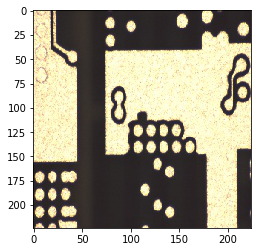

training set name:  train_NG_3_핀홀_112_B_1.png
training set label:  NG
IF measure:  0.00398747454286

## SHOW 7-MOST NEGLIGIBLE EXAMPLES ##



/home/hwehee/anaconda3/envs/cntk/lib/python3.5/site-packages/ipykernel/__main__.py:105: DeprecationWarning: `imsave` is deprecated!
`imsave` is deprecated in SciPy 1.0.0, and will be removed in 1.2.0.
Use ``imageio.imwrite`` instead.


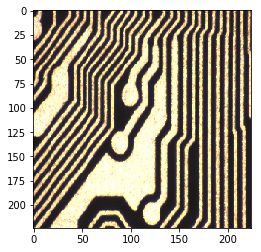

training set name:  train_OK_757_선간폭_551_C_1.png
training set label:  OK
IF measure:  -0.000210366421028


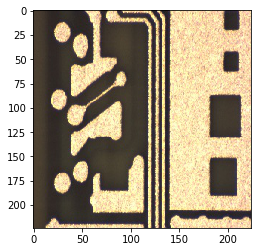

training set name:  train_OK_169_결손_1532_E_1.png
training set label:  OK
IF measure:  -0.000211664128665


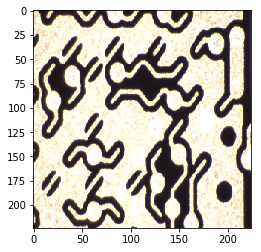

training set name:  train_OK_10_쇼트_9_A_1.png
training set label:  OK
IF measure:  -0.000212127482926


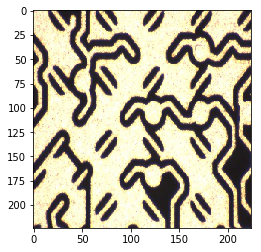

training set name:  train_OK_509_선간폭_257_A_1.png
training set label:  OK
IF measure:  -0.000214739659419


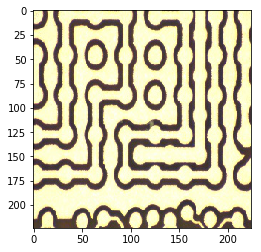

training set name:  train_OK_108_쇼트_464_D_1.png
training set label:  OK
IF measure:  -0.000216798559738


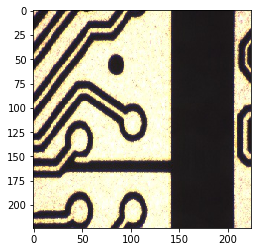

training set name:  train_OK_469_선간폭_228_A_1.png
training set label:  OK
IF measure:  -0.000219668703471


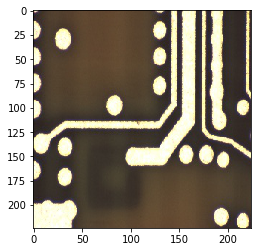

training set name:  train_OK_37_결손_2720_J_1.png
training set label:  OK
IF measure:  -0.000220179720465


/home/hwehee/anaconda3/envs/cntk/lib/python3.5/site-packages/ipykernel/__main__.py:120: DeprecationWarning: `imsave` is deprecated!
`imsave` is deprecated in SciPy 1.0.0, and will be removed in 1.2.0.
Use ``imageio.imwrite`` instead.


IF_val takes 449.7400896549225 sec
V_logreg takes 449.74125361442566 sec, and its max/min value [0.0012642209125543809, -0.00075410620955169169]

## SHOW 7-MOST DISADVANTAGEOUS EXAMPLES ##



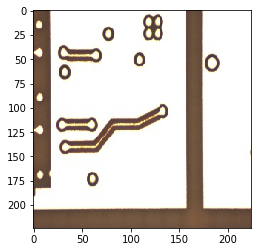

training set name:  train_NG_175_오픈_480_C_1.png
training set label:  NG
IF measure:  0.00126422091255
train_NG_175_오픈_480_C_1.png


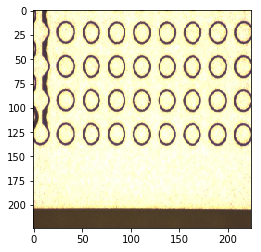

training set name:  train_NG_16_쇼트_449_B_1.png
training set label:  NG
IF measure:  0.00125918877266
train_NG_16_쇼트_449_B_1.png


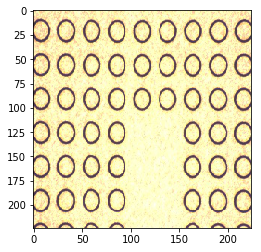

training set name:  train_NG_55_쇼트_2005_H_1.png
training set label:  NG
IF measure:  0.00125871777315
train_NG_55_쇼트_2005_H_1.png


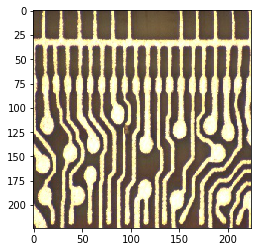

training set name:  train_NG_35_오픈_1371_I_1.png
training set label:  NG
IF measure:  0.00125574300222
train_NG_35_오픈_1371_I_1.png


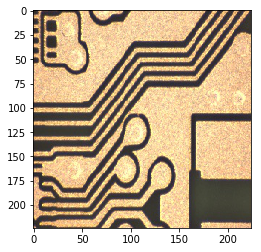

training set name:  train_NG_35_쇼트_593_F_1.png
training set label:  NG
IF measure:  0.00125444780097
train_NG_35_쇼트_593_F_1.png


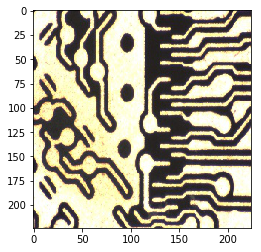

training set name:  train_NG_36_쇼트_1114_G_1.png
training set label:  NG
IF measure:  0.00125271773202
train_NG_36_쇼트_1114_G_1.png


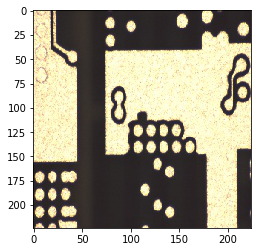

training set name:  train_NG_3_핀홀_112_B_1.png
training set label:  NG
IF measure:  0.00125265343416
train_NG_3_핀홀_112_B_1.png

## SHOW 7-MOST ADVANTAGEOUS EXAMPLES ##



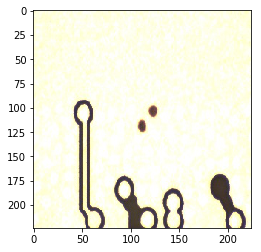

training set name:  train_OK_206_VH결함_1145_F_1.png
training set label:  OK
IF measure:  -0.000754106209552
train_OK_206_VH결함_1145_F_1.png


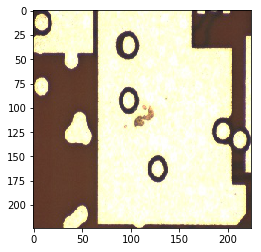

training set name:  train_OK_33_패드결함_4714_P_1.png
training set label:  OK
IF measure:  -0.000754093913435
train_OK_33_패드결함_4714_P_1.png


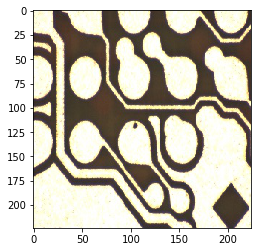

training set name:  train_OK_6_패드결함_432_D_1.png
training set label:  OK
IF measure:  -0.0007479106746
train_OK_6_패드결함_432_D_1.png


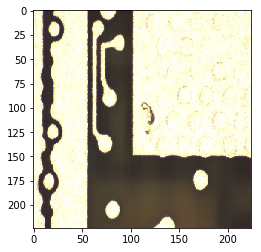

training set name:  train_OK_9_VH결함_2453_H_1.png
training set label:  OK
IF measure:  -0.000740661514986
train_OK_9_VH결함_2453_H_1.png


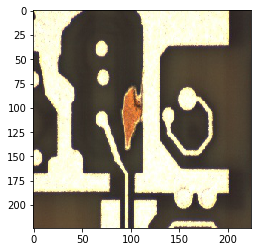

training set name:  train_OK_145_잔동_3026_J_1.png
training set label:  OK
IF measure:  -0.000739893208362
train_OK_145_잔동_3026_J_1.png


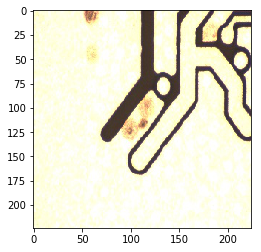

training set name:  train_OK_198_VH결함_1143_F_1.png
training set label:  OK
IF measure:  -0.000737841229
train_OK_198_VH결함_1143_F_1.png


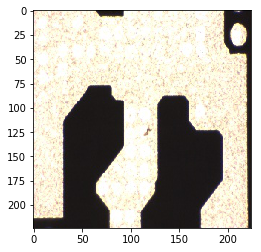

training set name:  train_OK_31_VH결함_7662_J_1.png
training set label:  OK
IF measure:  -0.000736426944069
train_OK_31_VH결함_7662_J_1.png

## SHOW 7-MOST INFLUENTIAL EXAMPLES ##



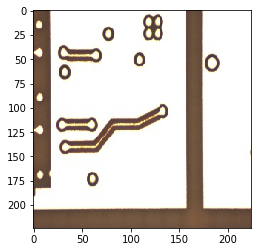

training set name:  train_NG_175_오픈_480_C_1.png
training set label:  NG
IF measure:  0.00126422091255


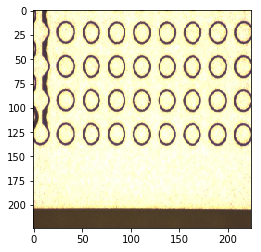

training set name:  train_NG_16_쇼트_449_B_1.png
training set label:  NG
IF measure:  0.00125918877266


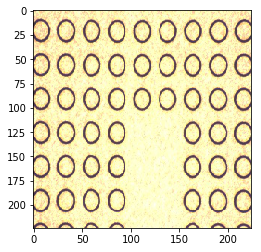

training set name:  train_NG_55_쇼트_2005_H_1.png
training set label:  NG
IF measure:  0.00125871777315


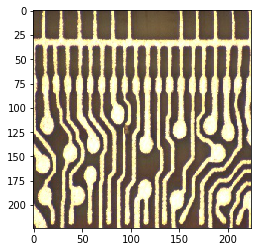

training set name:  train_NG_35_오픈_1371_I_1.png
training set label:  NG
IF measure:  0.00125574300222


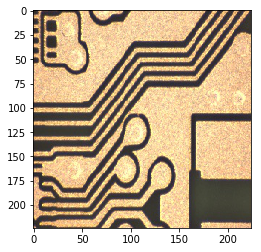

training set name:  train_NG_35_쇼트_593_F_1.png
training set label:  NG
IF measure:  0.00125444780097


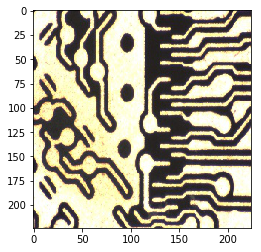

training set name:  train_NG_36_쇼트_1114_G_1.png
training set label:  NG
IF measure:  0.00125271773202


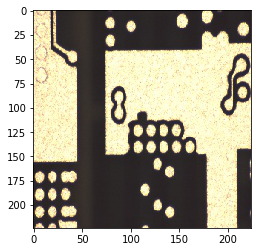

training set name:  train_NG_3_핀홀_112_B_1.png
training set label:  NG
IF measure:  0.00125265343416

## SHOW 7-MOST NEGLIGIBLE EXAMPLES ##



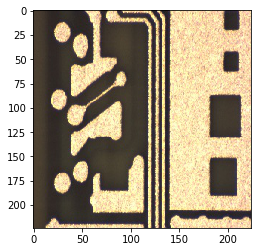

training set name:  train_OK_169_결손_1532_E_1.png
training set label:  OK
IF measure:  -6.64237317581e-05


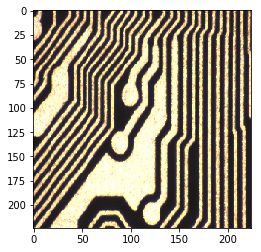

training set name:  train_OK_757_선간폭_551_C_1.png
training set label:  OK
IF measure:  -6.68637798248e-05


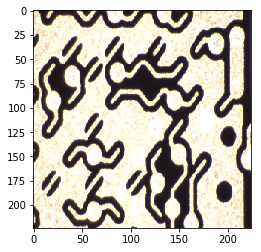

training set name:  train_OK_10_쇼트_9_A_1.png
training set label:  OK
IF measure:  -6.79835779895e-05


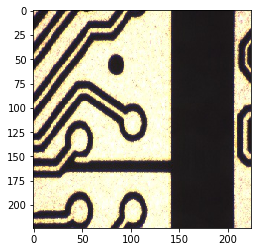

training set name:  train_OK_469_선간폭_228_A_1.png
training set label:  OK
IF measure:  -6.8193569739e-05


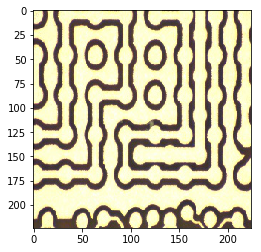

training set name:  train_OK_108_쇼트_464_D_1.png
training set label:  OK
IF measure:  -6.83773740078e-05


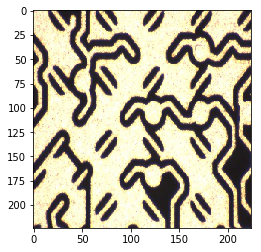

training set name:  train_OK_509_선간폭_257_A_1.png
training set label:  OK
IF measure:  -6.86530012143e-05


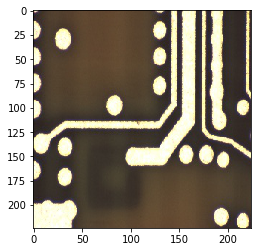

training set name:  train_OK_37_결손_2720_J_1.png
training set label:  OK
IF measure:  -6.97974201875e-05
IF_val takes 1884.0981481075287 sec
V takes 1884.0995519161224 sec, and its max/min value [0.0022152101083078531, -0.0011966106823172291]

## SHOW 7-MOST DISADVANTAGEOUS EXAMPLES ##



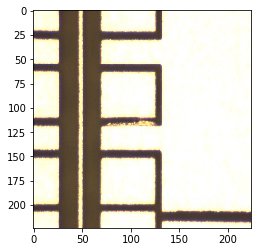

training set name:  train_NG_143_선간폭_1226_F_1.png
training set label:  NG
IF measure:  0.00221521010831
train_NG_143_선간폭_1226_F_1.png


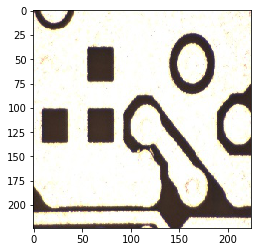

training set name:  train_NG_93_선간폭_1345_J_1.png
training set label:  NG
IF measure:  0.00215958076884
train_NG_93_선간폭_1345_J_1.png


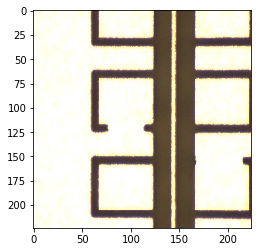

training set name:  train_NG_577_쇼트_1955_H_1.png
training set label:  NG
IF measure:  0.00215372194729
train_NG_577_쇼트_1955_H_1.png


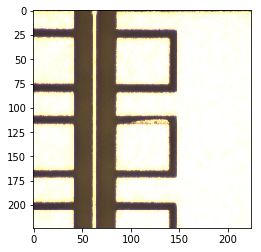

training set name:  train_NG_347_선간폭_1738_G_1.png
training set label:  NG
IF measure:  0.00214492355464
train_NG_347_선간폭_1738_G_1.png


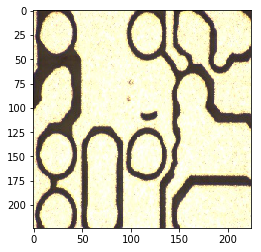

training set name:  train_NG_36_쇼트_208_B_1.png
training set label:  NG
IF measure:  0.00209648575215
train_NG_36_쇼트_208_B_1.png


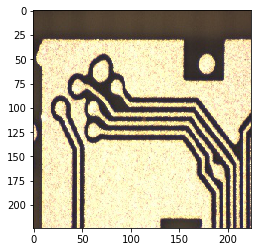

training set name:  train_NG_297_선간폭_3048_J_1.png
training set label:  NG
IF measure:  0.00203249165028
train_NG_297_선간폭_3048_J_1.png


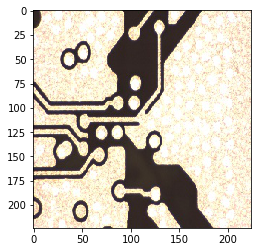

training set name:  train_NG_68_쇼트_1894_F_1.png
training set label:  NG
IF measure:  0.00199999087856
train_NG_68_쇼트_1894_F_1.png

## SHOW 7-MOST ADVANTAGEOUS EXAMPLES ##



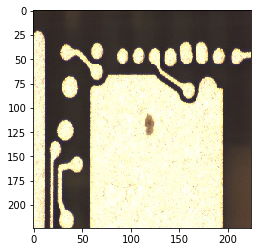

training set name:  train_OK_7_VH결함_2234_G_1.png
training set label:  OK
IF measure:  -0.00119661068232
train_OK_7_VH결함_2234_G_1.png


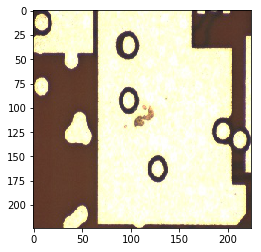

training set name:  train_OK_33_패드결함_4714_P_1.png
training set label:  OK
IF measure:  -0.00115902401799
train_OK_33_패드결함_4714_P_1.png


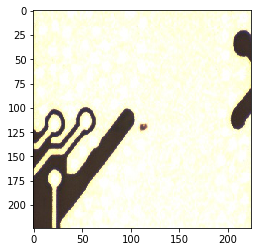

training set name:  train_OK_333_VH결함_3654_N_1.png
training set label:  OK
IF measure:  -0.00112485764339
train_OK_333_VH결함_3654_N_1.png


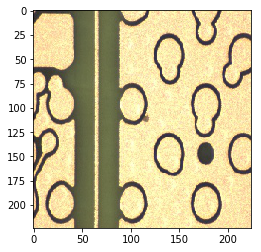

training set name:  train_OK_197_선간폭_680_G_1.png
training set label:  OK
IF measure:  -0.00111124633849
train_OK_197_선간폭_680_G_1.png


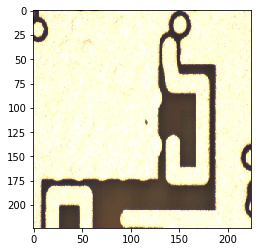

training set name:  train_OK_25_VH결함_410_A_1.png
training set label:  OK
IF measure:  -0.0011079335035
train_OK_25_VH결함_410_A_1.png


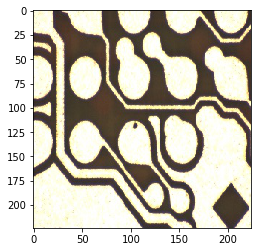

training set name:  train_OK_6_패드결함_432_D_1.png
training set label:  OK
IF measure:  -0.00108682805928
train_OK_6_패드결함_432_D_1.png


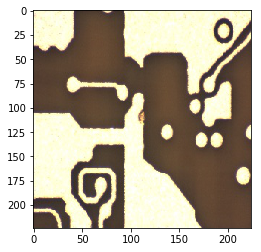

training set name:  train_OK_37_VH결함_1827_E_1.png
training set label:  OK
IF measure:  -0.00107802555907
train_OK_37_VH결함_1827_E_1.png

## SHOW 7-MOST INFLUENTIAL EXAMPLES ##



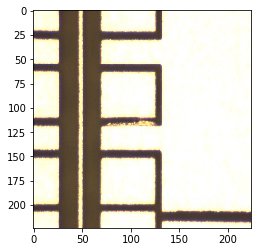

training set name:  train_NG_143_선간폭_1226_F_1.png
training set label:  NG
IF measure:  0.00221521010831


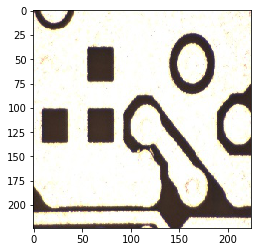

training set name:  train_NG_93_선간폭_1345_J_1.png
training set label:  NG
IF measure:  0.00215958076884


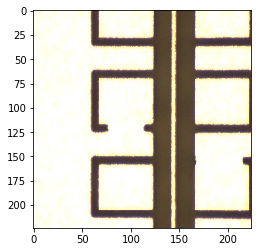

training set name:  train_NG_577_쇼트_1955_H_1.png
training set label:  NG
IF measure:  0.00215372194729


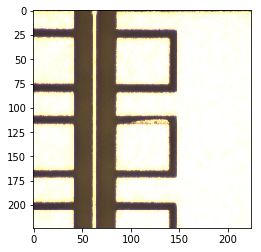

training set name:  train_NG_347_선간폭_1738_G_1.png
training set label:  NG
IF measure:  0.00214492355464


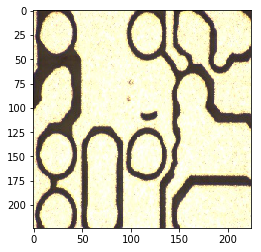

training set name:  train_NG_36_쇼트_208_B_1.png
training set label:  NG
IF measure:  0.00209648575215


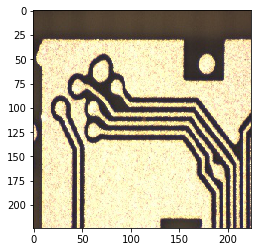

training set name:  train_NG_297_선간폭_3048_J_1.png
training set label:  NG
IF measure:  0.00203249165028


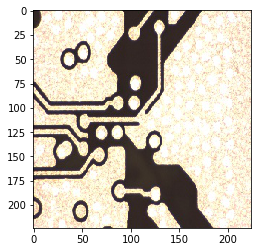

training set name:  train_NG_68_쇼트_1894_F_1.png
training set label:  NG
IF measure:  0.00199999087856

## SHOW 7-MOST NEGLIGIBLE EXAMPLES ##



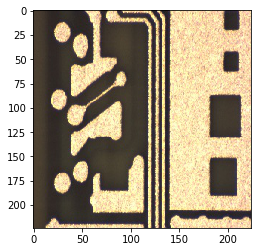

training set name:  train_OK_169_결손_1532_E_1.png
training set label:  OK
IF measure:  -7.33901121817e-05


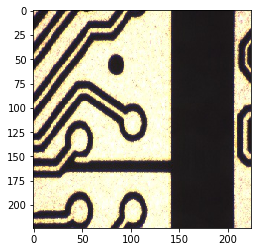

training set name:  train_OK_469_선간폭_228_A_1.png
training set label:  OK
IF measure:  -7.63212736245e-05


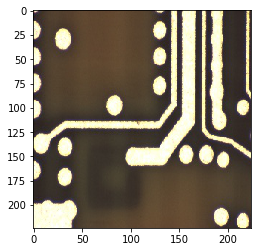

training set name:  train_OK_37_결손_2720_J_1.png
training set label:  OK
IF measure:  -7.65740321176e-05


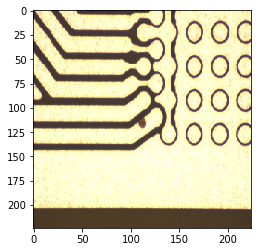

training set name:  train_OK_40_결손_1459_E_1.png
training set label:  OK
IF measure:  -7.84046629255e-05


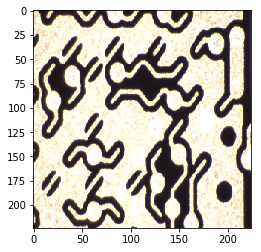

training set name:  train_OK_10_쇼트_9_A_1.png
training set label:  OK
IF measure:  -7.85164395606e-05


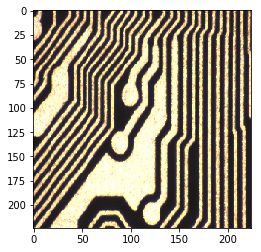

training set name:  train_OK_757_선간폭_551_C_1.png
training set label:  OK
IF measure:  -7.87020437018e-05


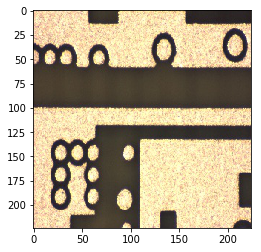

training set name:  train_OK_38_선간폭_1696_F_1.png
training set label:  OK
IF measure:  -8.031280049e-05
IF_val takes 453.44195556640625 sec
V_cos takes 453.44302225112915 sec, and its max/min value [8.3507981345168659e-05, -8.3504212440952517e-05]

## SHOW 7-MOST DISADVANTAGEOUS EXAMPLES ##



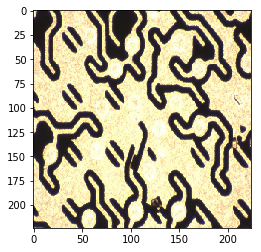

training set name:  train_NG_70_쇼트_360_D_1.png
training set label:  NG
IF measure:  8.35079813452e-05
train_NG_70_쇼트_360_D_1.png


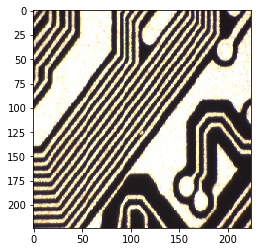

training set name:  train_NG_91_쇼트_1090_H_1.png
training set label:  NG
IF measure:  8.35051638259e-05
train_NG_91_쇼트_1090_H_1.png


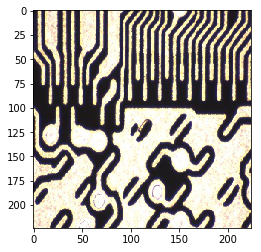

training set name:  train_NG_285_쇼트_362_D_1.png
training set label:  NG
IF measure:  8.35044236526e-05
train_NG_285_쇼트_362_D_1.png


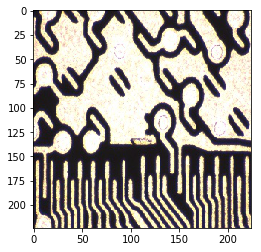

training set name:  train_NG_80_쇼트_278_B_1.png
training set label:  NG
IF measure:  8.35036097267e-05
train_NG_80_쇼트_278_B_1.png


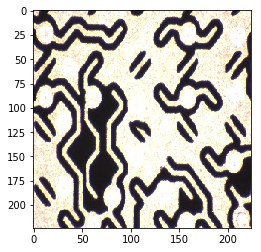

training set name:  train_NG_595_오픈_520_D_1.png
training set label:  NG
IF measure:  8.3499920651e-05
train_NG_595_오픈_520_D_1.png


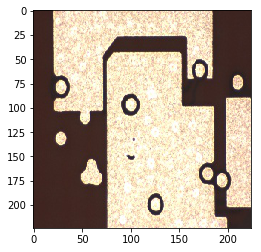

training set name:  train_NG_94_쇼트_6313_P_1.png
training set label:  NG
IF measure:  8.34997684534e-05
train_NG_94_쇼트_6313_P_1.png


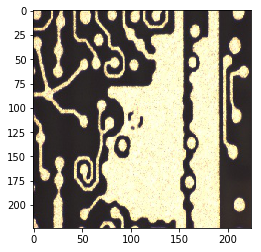

training set name:  train_NG_35_쇼트_3118_J_1.png
training set label:  NG
IF measure:  8.34974601041e-05
train_NG_35_쇼트_3118_J_1.png

## SHOW 7-MOST ADVANTAGEOUS EXAMPLES ##



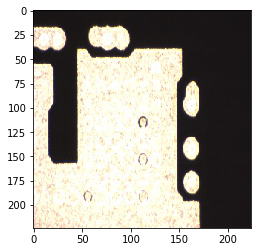

training set name:  train_OK_93_VH결함_12797_N_1.png
training set label:  OK
IF measure:  -8.3504212441e-05
train_OK_93_VH결함_12797_N_1.png


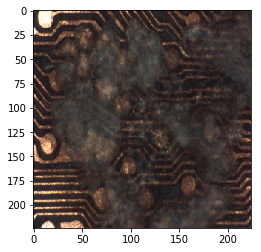

training set name:  train_OK_814_쇼트_531_D_1.png
training set label:  OK
IF measure:  -8.34992153087e-05
train_OK_814_쇼트_531_D_1.png


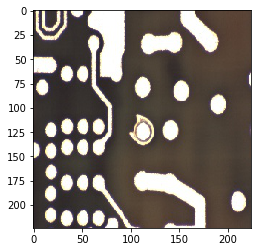

training set name:  train_OK_32_잔동_628_A_1.png
training set label:  OK
IF measure:  -8.34955832017e-05
train_OK_32_잔동_628_A_1.png


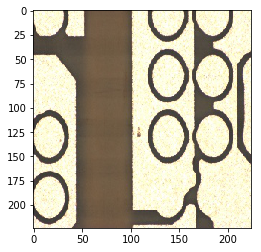

training set name:  train_OK_89_패드결함_1479_J_1.png
training set label:  OK
IF measure:  -8.34933714648e-05
train_OK_89_패드결함_1479_J_1.png


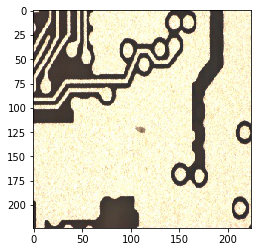

training set name:  train_OK_10_VH결함_986_D_1.png
training set label:  OK
IF measure:  -8.34932302159e-05
train_OK_10_VH결함_986_D_1.png


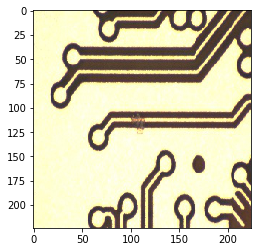

training set name:  train_OK_277_결손_905_H_1.png
training set label:  OK
IF measure:  -8.34926136654e-05
train_OK_277_결손_905_H_1.png


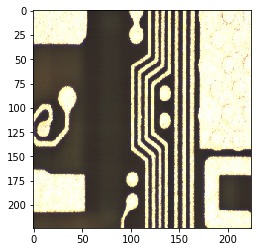

training set name:  train_OK_10_선간폭_1676_E_1.png
training set label:  OK
IF measure:  -8.34899883482e-05
train_OK_10_선간폭_1676_E_1.png

## SHOW 7-MOST INFLUENTIAL EXAMPLES ##



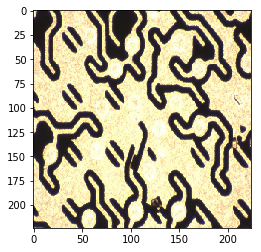

training set name:  train_NG_70_쇼트_360_D_1.png
training set label:  NG
IF measure:  8.35079813452e-05


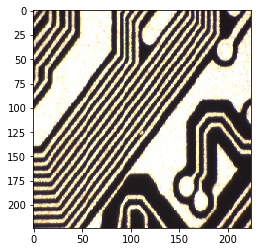

training set name:  train_NG_91_쇼트_1090_H_1.png
training set label:  NG
IF measure:  8.35051638259e-05


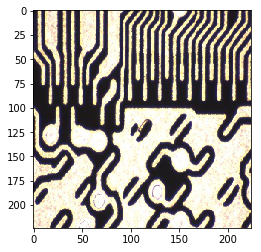

training set name:  train_NG_285_쇼트_362_D_1.png
training set label:  NG
IF measure:  8.35044236526e-05


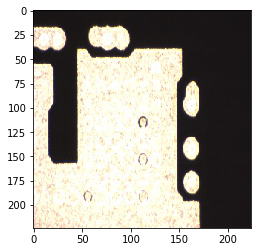

training set name:  train_OK_93_VH결함_12797_N_1.png
training set label:  OK
IF measure:  -8.3504212441e-05


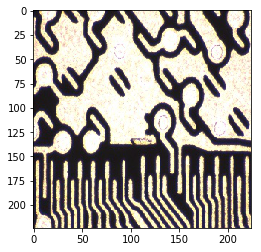

training set name:  train_NG_80_쇼트_278_B_1.png
training set label:  NG
IF measure:  8.35036097267e-05


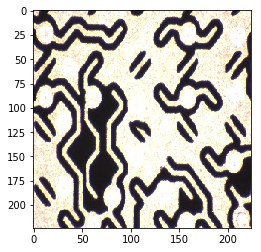

training set name:  train_NG_595_오픈_520_D_1.png
training set label:  NG
IF measure:  8.3499920651e-05


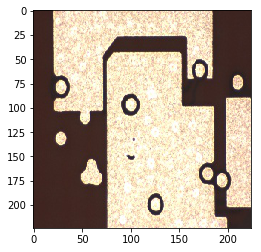

training set name:  train_NG_94_쇼트_6313_P_1.png
training set label:  NG
IF measure:  8.34997684534e-05

## SHOW 7-MOST NEGLIGIBLE EXAMPLES ##



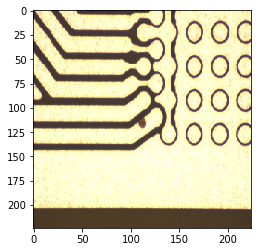

training set name:  train_OK_40_결손_1459_E_1.png
training set label:  OK
IF measure:  -8.29897359304e-05


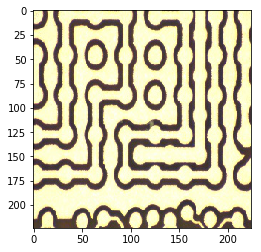

training set name:  train_OK_108_쇼트_464_D_1.png
training set label:  OK
IF measure:  -8.30104020093e-05


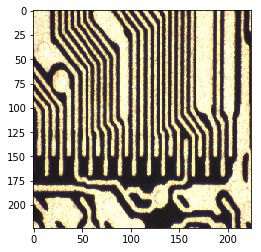

training set name:  train_OK_310_선간폭_155_A_1.png
training set label:  OK
IF measure:  -8.30120628273e-05


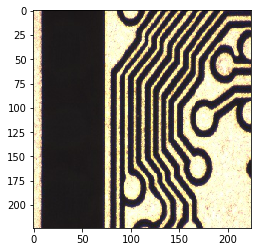

training set name:  train_OK_873_선간폭_911_H_1.png
training set label:  OK
IF measure:  -8.30235604185e-05


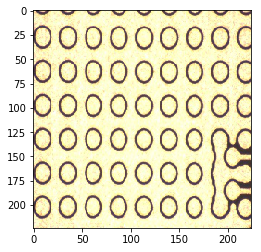

training set name:  train_OK_129_선간폭_1204_F_1.png
training set label:  OK
IF measure:  -8.30262289887e-05


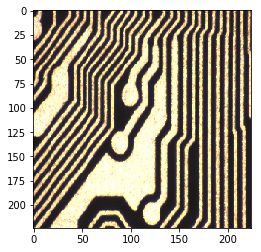

training set name:  train_OK_757_선간폭_551_C_1.png
training set label:  OK
IF measure:  -8.3028749452e-05


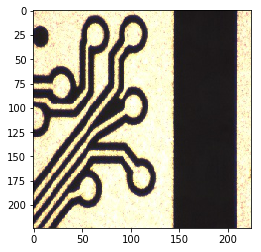

training set name:  train_OK_128_선간폭_181_B_1.png
training set label:  OK
IF measure:  -8.30296756913e-05
Recursion depth: 0, norm: 5229.875439183518, time: 192.76405334472656 

Recursion depth: 1, norm: 9835.361787956761, time: 192.81797194480896 

Recursion depth: 2, norm: 13903.839478719538, time: 193.01929259300232 

Recursion depth: 3, norm: 17498.081752009275, time: 192.81174898147583 

Recursion depth: 4, norm: 20673.60421527896, time: 192.84592580795288 

Recursion depth: 5, norm: 23478.857329520957, time: 192.82069754600525 

Recursion depth: 6, norm: 25957.38256257745, time: 192.98550724983215 

Recursion depth: 7, norm: 28146.9170691925, time: 192.92560601234436 

Recursion depth: 8, norm: 30080.99075828454, time: 193.08468198776245 

Recursion depth: 9, norm: 31789.917293066366, time: 193.01347374916077 

Recursion depth: 10, norm: 33299.56002712348, time: 192.95496034622192 

Recursion depth: 11, norm: 34633.34451074571, time: 193.05273127555847 

Recursion depth: 12, norm:

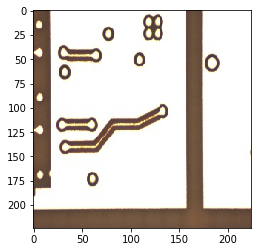

training set name:  train_NG_175_오픈_480_C_1.png
training set label:  NG
IF measure:  0.0108955254971
train_NG_175_오픈_480_C_1.png


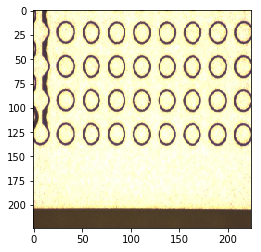

training set name:  train_NG_16_쇼트_449_B_1.png
training set label:  NG
IF measure:  0.0108529127903
train_NG_16_쇼트_449_B_1.png


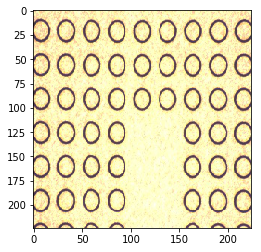

training set name:  train_NG_55_쇼트_2005_H_1.png
training set label:  NG
IF measure:  0.0108488558475
train_NG_55_쇼트_2005_H_1.png


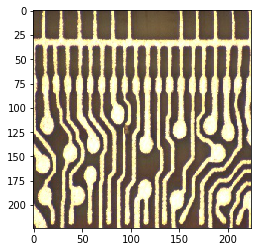

training set name:  train_NG_35_오픈_1371_I_1.png
training set label:  NG
IF measure:  0.0108233819046
train_NG_35_오픈_1371_I_1.png


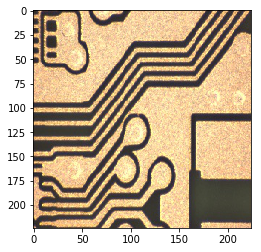

training set name:  train_NG_35_쇼트_593_F_1.png
training set label:  NG
IF measure:  0.0108119690599
train_NG_35_쇼트_593_F_1.png


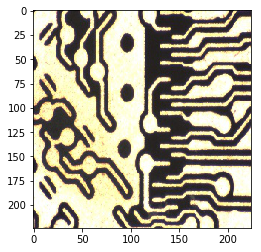

training set name:  train_NG_36_쇼트_1114_G_1.png
training set label:  NG
IF measure:  0.0107972067048
train_NG_36_쇼트_1114_G_1.png


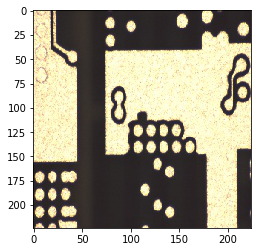

training set name:  train_NG_3_핀홀_112_B_1.png
training set label:  NG
IF measure:  0.010797167465
train_NG_3_핀홀_112_B_1.png

## SHOW 7-MOST ADVANTAGEOUS EXAMPLES ##



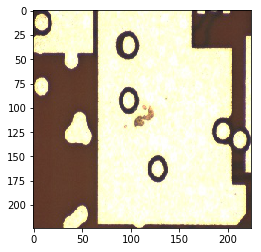

training set name:  train_OK_33_패드결함_4714_P_1.png
training set label:  OK
IF measure:  -0.00650624046068
train_OK_33_패드결함_4714_P_1.png


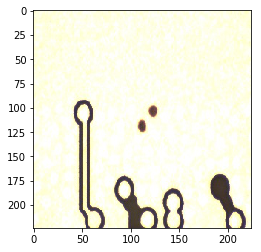

training set name:  train_OK_206_VH결함_1145_F_1.png
training set label:  OK
IF measure:  -0.00650617187192
train_OK_206_VH결함_1145_F_1.png


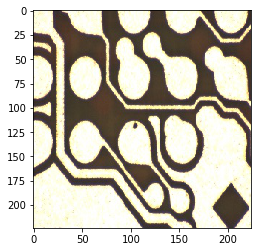

training set name:  train_OK_6_패드결함_432_D_1.png
training set label:  OK
IF measure:  -0.00645349302391
train_OK_6_패드결함_432_D_1.png


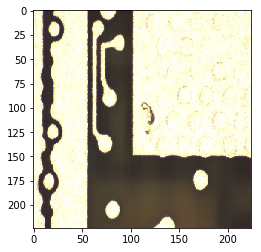

training set name:  train_OK_9_VH결함_2453_H_1.png
training set label:  OK
IF measure:  -0.00639052597877
train_OK_9_VH결함_2453_H_1.png


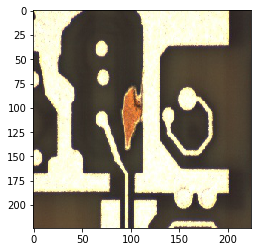

training set name:  train_OK_145_잔동_3026_J_1.png
training set label:  OK
IF measure:  -0.00638433765642
train_OK_145_잔동_3026_J_1.png


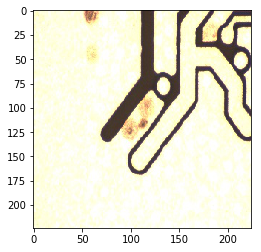

training set name:  train_OK_198_VH결함_1143_F_1.png
training set label:  OK
IF measure:  -0.00636617426562
train_OK_198_VH결함_1143_F_1.png


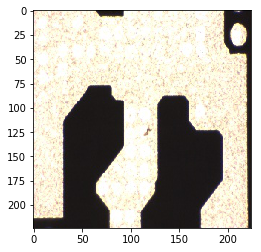

training set name:  train_OK_31_VH결함_7662_J_1.png
training set label:  OK
IF measure:  -0.00635411029938
train_OK_31_VH결함_7662_J_1.png

## SHOW 7-MOST INFLUENTIAL EXAMPLES ##



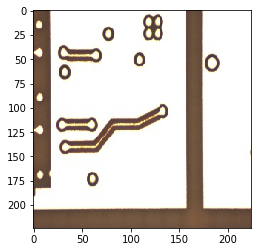

training set name:  train_NG_175_오픈_480_C_1.png
training set label:  NG
IF measure:  0.0108955254971


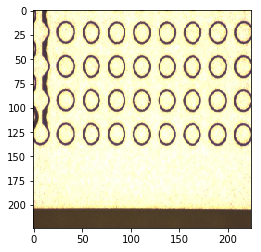

training set name:  train_NG_16_쇼트_449_B_1.png
training set label:  NG
IF measure:  0.0108529127903


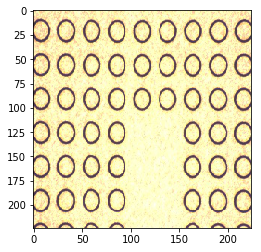

training set name:  train_NG_55_쇼트_2005_H_1.png
training set label:  NG
IF measure:  0.0108488558475


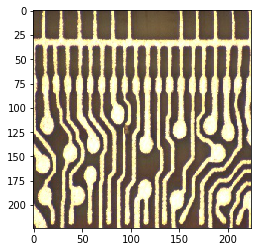

training set name:  train_NG_35_오픈_1371_I_1.png
training set label:  NG
IF measure:  0.0108233819046


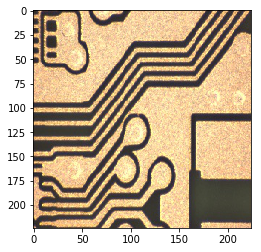

training set name:  train_NG_35_쇼트_593_F_1.png
training set label:  NG
IF measure:  0.0108119690599


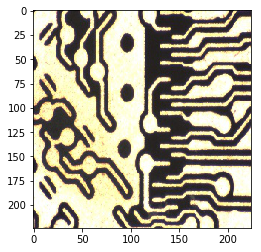

training set name:  train_NG_36_쇼트_1114_G_1.png
training set label:  NG
IF measure:  0.0107972067048


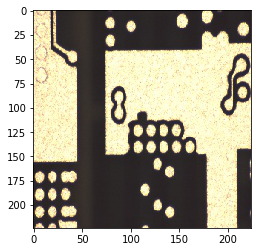

training set name:  train_NG_3_핀홀_112_B_1.png
training set label:  NG
IF measure:  0.010797167465

## SHOW 7-MOST NEGLIGIBLE EXAMPLES ##



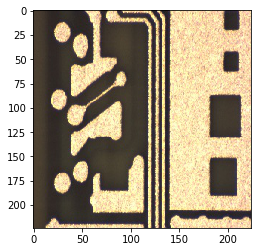

training set name:  train_OK_169_결손_1532_E_1.png
training set label:  OK
IF measure:  -0.000572218144929


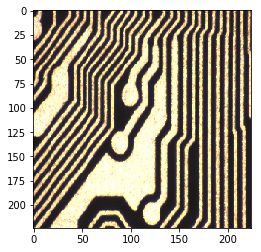

training set name:  train_OK_757_선간폭_551_C_1.png
training set label:  OK
IF measure:  -0.000575973392996


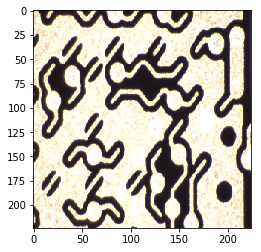

training set name:  train_OK_10_쇼트_9_A_1.png
training set label:  OK
IF measure:  -0.000585651170937


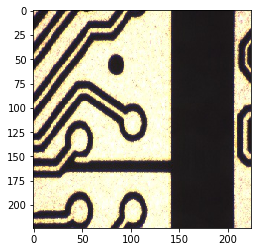

training set name:  train_OK_469_선간폭_228_A_1.png
training set label:  OK
IF measure:  -0.000587473455947


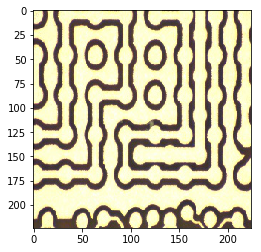

training set name:  train_OK_108_쇼트_464_D_1.png
training set label:  OK
IF measure:  -0.000589059020253


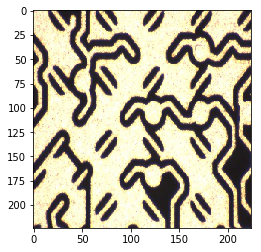

training set name:  train_OK_509_선간폭_257_A_1.png
training set label:  OK
IF measure:  -0.000591392262582


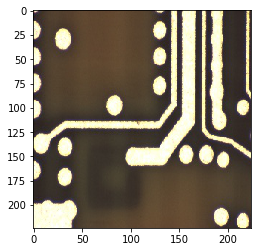

training set name:  train_OK_37_결손_2720_J_1.png
training set label:  OK
IF measure:  -0.000601290668955


In [16]:
# DO THIS FOR SEVERAL EXAMPLES

# WRONG AND OK

# vec v.s. freeze v.s. se

# restore trainval_list, test_list
file_dir = './wrong/lg-full'

trainval_list = list(np.load(file_dir+'/trainval_list.npy'))
train_set = dataset.LazyDataset(root_dir, trainval_list, anno_dict) # non-noisy dataset

test_list = list(np.load(file_dir+'/test_list.npy'))
msk_wrong_ok = [ys[i,0] * (1-ys[i,y_pred]) for i,y_pred in enumerate(y_preds.argmax(axis=1))]
test_list = [tl for tl, msk in zip(test_list,msk_wrong_ok) if msk]
test_set = dataset.LazyDataset(root_dir, test_list, anno_dict)

# FIXME
train_set = dataset.LazyDataset(root_dir, trainval_list, anno_dict)
save_dir = './wrong/lg-full/' 
restore_dir = '/Data/checkpts/lg/model_fold_1_trainval_ratio_1.0.dnn'

for idx_test in range(0, 2):
    # Set a single test image

    # # Re-sample a test instance
    # test_list, _ = dataset.read_data_subset(root_dir, mode='validation1', sample_size=100)
    # test_set = dataset.LazyDataset(root_dir, test_list, anno_dict)
    
    # Restore weights
    net.logits.restore(restore_dir)

    params = net.logits.parameters

    name_test = test_list[idx_test]
    img_test, lb_test = test_set.__getitem__(idx_test)
    show_image_from_data(img_test)
    v_test = net.loss.grad({net.X:img_test, net.y:lb_test}, wrt=params)
    
    lb_true = anno_dict['classes'][str(np.argmax(lb_test))]
    lb_pred = anno_dict['classes'][str(np.argmax(net.logits.eval({net.X:img_test})))]
    print('testfile name: ', name_test)
    print('ground truth label: ', lb_true)
    print('network prediction: ', lb_pred)

    save_path = os.path.join(save_dir, name_test.split('.')[0])
    
    if not os.path.exists(save_path):
        # make folder
        os.makedirs(save_path)
        
    scipy.misc.imsave(save_path+'/test_reference_true_{}_pred_{}.png'.format(lb_true,lb_pred), np.transpose(img_test,(1,2,0)))

    np.save(save_path+'/trainval_list', trainval_list)
    np.save(save_path+'/test_list', test_list)

    # CALCULATE IF WITH FREEZED NETWORK

    params = net.loss.parameters
    p_ftex = net.d['conv5_2'].parameters
    p_logreg = tuple(set(params) - set(p_ftex)) # extract the weights of the last-layer (w,b)
    print(p_logreg)
    v_logreg = net.loss.grad({net.X:img_test, net.y:lb_test}, wrt=p_logreg)

    # Calculate influence functions
    ns = 7

    # CG-FREEZE (1885 sec)
    t1 = time.time()
    ihvp_cg_logreg = get_inverse_hvp_cg(net, net.loss, v_logreg, train_set,**{'damping':0.0, 'maxiter':50})
    IF_cg_logreg = IF_val(net, ihvp_cg_logreg, train_set)
    print('CG_logreg takes {} sec, and its max/min value {}'.format(time.time()-t1, [max(IF_cg_logreg),min(IF_cg_logreg)]))
    np.save(save_path+'/if_cg_logreg.npy', IF_cg_logreg)
    #IF_cg_logreg = np.load(save_path+'/if_cg_logreg.npy')
    visualize_topk_samples(IF_cg_logreg, train_set, num_sample=ns, save_path=save_path+'/cg-frz')
    
    # VECTOR-FREEZE (175 sec)
    t1 = time.time()
    IF_v_logreg = IF_val(net, v_logreg, train_set)
    print('V_logreg takes {} sec, and its max/min value {}'.format(time.time()-t1, [max(IF_v_logreg),min(IF_v_logreg)]))
    np.save(save_path+'/if_v_logreg.npy', IF_v_logreg)
    #IF_v_logreg = np.load(save_path+'/if_v_logreg.npy')
    visualize_topk_samples(IF_v_logreg, train_set, num_sample=ns, save_path=save_path+'/vec-frz')

    # Vector-FULL (1688 sec)
    t1 = time.time()
    IF_v = IF_val(net, v_test, train_set)
    print('V takes {} sec, and its max/min value {}'.format(time.time()-t1, [max(IF_v),min(IF_v)]))
    np.save(save_path+'/if_v.npy', IF_v)
    #IF_v = np.load(save_path+'/if_v.npy')
    visualize_topk_samples(IF_v, train_set, num_sample=ns, save_path=save_path+'/v')
    
    # VECTOR-FREEZE-cosine-similarity (178 sec)
    t1 = time.time()
    IF_v_cos = IF_val(net, v_logreg, train_set, cosine=True)
    print('V_cos takes {} sec, and its max/min value {}'.format(time.time()-t1, [max(IF_v_cos),min(IF_v_cos)]))
    np.save(save_path+'/if_v_cos.npy', IF_v_cos)
    #IF_v_cos = np.load(save_path+'/if_v_cos.npy')
    visualize_topk_samples(IF_v_cos, train_set, num_sample=ns, save_path=save_path+'/vec-cos')

#     # CG-FULL (1epoch, more than 3 hours, did it stuck at line search as it happened in ncg?)
#     t1 = time.time()
#     ihvp_cg = get_inverse_hvp_cg(net, net.loss, v_test, train_set,**{'damping':0.1, 'maxiter':100})
#     IF_cg = IF_val(net, ihvp_cg, train_set)
#     print('CG takes {} sec, and its max/min value {}'.format(time.time()-t1, [max(IF_cg),min(IF_cg)]))
#     np.save(save_path+'/if_cg.npy', IF_cg)
#     visualize_topk_samples(IF_cg, train_set, num_sample=ns, save_path=save_path+'/cg')
    
#     # SE-FULL (? sec: diverge)
#     t1 = time.time()
#     ihvp_se = get_inverse_hvp_se(net, net.loss, v_test, train_set,**{'scale':1e5, 'damping':0.1, 'batch_size':50, 'recursion_depth':100})
#     IF_se = IF_val(net, ihvp_se, train_set)
#     print('SE takes {} sec, and its max/min value {}'.format(time.time()-t1, [max(IF_se),min(IF_se)]))
#     np.save(save_path+'/if_se.npy', IF_se)
#     visualize_topk_samples(IF_se, train_set, num_sample=ns, save_path=save_path+'/se')
    
    # SE-FREEZE (1065 sec)
    t1 = time.time()
    ihvp_se_logreg = get_inverse_hvp_se(net, net.loss, v_logreg, train_set,**{'scale':1e3, 'damping':0.1, 'batch_size':50, 'tolerance':0, 'recursion_depth':100})
    IF_se_logreg = IF_val(net, ihvp_se_logreg, train_set)
    print('SE_logreg takes {} sec, and its max/min value {}'.format(time.time()-t1, [max(IF_se_logreg),min(IF_se_logreg)]))
    np.save(save_path+'/if_se_logreg.npy', IF_se_logreg)
    #IF_se_logreg = np.load(save_path+'/if_se_logreg.npy')
    visualize_topk_samples(IF_se_logreg, train_set, num_sample=ns, save_path=save_path+'/se-frz')

In [ ]:
# DO THIS FOR SEVERAL EXAMPLES

# WRONG AND NG

# vec v.s. freeze v.s. se

# restore trainval_list, test_list
file_dir = './compare/lg/train_NG_279_쇼트_1648_H_1'

trainval_list = list(np.load(file_dir+'/trainval_list.npy'))
train_set = dataset.LazyDataset(root_dir, trainval_list, anno_dict) # non-noisy dataset

test_list = list(np.load(file_dir+'/test_list.npy'))
msk_wrong_ng = [ys[i,1] * (1-ys[i,y_pred]) for i,y_pred in enumerate(y_preds.argmax(axis=1))]
test_list= [tl for tl, msk in zip(test_list,msk_wrong_ng) if msk]
test_set = dataset.LazyDataset(root_dir, test_list, anno_dict)

# FIXME
train_set = dataset.LazyDataset(root_dir, trainval_list, anno_dict)
save_dir = './wrong/lg-full/' 
restore_dir = '/Data/checkpts/lg/model_fold_1_trainval_ratio_1.0.dnn'

for idx_test in range(0, 2):
    # Set a single test image

    # # Re-sample a test instance
    # test_list, _ = dataset.read_data_subset(root_dir, mode='validation1', sample_size=100)
    # test_set = dataset.LazyDataset(root_dir, test_list, anno_dict)
    
    # Restore weights
    net.logits.restore(restore_dir)

    params = net.logits.parameters

    name_test = test_list[idx_test]
    img_test, lb_test = test_set.__getitem__(idx_test)
    show_image_from_data(img_test)
    v_test = net.loss.grad({net.X:img_test, net.y:lb_test}, wrt=params)
    
    lb_true = anno_dict['classes'][str(np.argmax(lb_test))]
    lb_pred = anno_dict['classes'][str(np.argmax(net.logits.eval({net.X:img_test})))]
    print('testfile name: ', name_test)
    print('ground truth label: ', lb_true)
    print('network prediction: ', lb_pred)

    save_path = os.path.join(save_dir, name_test.split('.')[0])
    
    if not os.path.exists(save_path):
        # make folder
        os.makedirs(save_path)
        
    scipy.misc.imsave(save_path+'/test_reference_true_{}_pred_{}.png'.format(lb_true,lb_pred), np.transpose(img_test,(1,2,0)))

    np.save(save_path+'/trainval_list', trainval_list)
    np.save(save_path+'/test_list', test_list)

    # CALCULATE IF WITH FREEZED NETWORK

    params = net.loss.parameters
    p_ftex = net.d['conv5_2'].parameters
    p_logreg = tuple(set(params) - set(p_ftex)) # extract the weights of the last-layer (w,b)
    print(p_logreg)
    v_logreg = net.loss.grad({net.X:img_test, net.y:lb_test}, wrt=p_logreg)

    # Calculate influence functions
    ns = 10

    # CG-FREEZE (1885 sec)
    t1 = time.time()
    ihvp_cg_logreg = get_inverse_hvp_cg(net, net.loss, v_logreg, train_set,**{'damping':0.0, 'maxiter':50})
    IF_cg_logreg = IF_val(net, ihvp_cg_logreg, train_set)
    print('CG_logreg takes {} sec, and its max/min value {}'.format(time.time()-t1, [max(IF_cg_logreg),min(IF_cg_logreg)]))
    np.save(save_path+'/if_cg_logreg.npy', IF_cg_logreg)
    #IF_cg_logreg = np.load(save_path+'/if_cg_logreg.npy')
    visualize_topk_samples(IF_cg_logreg, train_set, num_sample=ns, save_path=save_path+'/cg-frz')
    
    # VECTOR-FREEZE (175 sec)
    t1 = time.time()
    IF_v_logreg = IF_val(net, v_logreg, train_set)
    print('V_logreg takes {} sec, and its max/min value {}'.format(time.time()-t1, [max(IF_v_logreg),min(IF_v_logreg)]))
    np.save(save_path+'/if_v_logreg.npy', IF_v_logreg)
    #IF_v_logreg = np.load(save_path+'/if_v_logreg.npy')
    visualize_topk_samples(IF_v_logreg, train_set, num_sample=ns, save_path=save_path+'/vec-frz')

    # Vector-FULL (1688 sec)
    t1 = time.time()
    IF_v = IF_val(net, v_test, train_set)
    print('V takes {} sec, and its max/min value {}'.format(time.time()-t1, [max(IF_v),min(IF_v)]))
    np.save(save_path+'/if_v.npy', IF_v)
    #IF_v = np.load(save_path+'/if_v.npy')
    visualize_topk_samples(IF_v, train_set, num_sample=ns, save_path=save_path+'/v')
    
    # VECTOR-FREEZE-cosine-similarity (178 sec)
    t1 = time.time()
    IF_v_cos = IF_val(net, v_logreg, train_set, cosine=True)
    print('V_cos takes {} sec, and its max/min value {}'.format(time.time()-t1, [max(IF_v_cos),min(IF_v_cos)]))
    np.save(save_path+'/if_v_cos.npy', IF_v_cos)
    #IF_v_cos = np.load(save_path+'/if_v_cos.npy')
    visualize_topk_samples(IF_v_cos, train_set, num_sample=ns, save_path=save_path+'/vec-cos')

#     # CG-FULL (1epoch, more than 3 hours, did it stuck at line search as it happened in ncg?)
#     t1 = time.time()
#     ihvp_cg = get_inverse_hvp_cg(net, net.loss, v_test, train_set,**{'damping':0.1, 'maxiter':100})
#     IF_cg = IF_val(net, ihvp_cg, train_set)
#     print('CG takes {} sec, and its max/min value {}'.format(time.time()-t1, [max(IF_cg),min(IF_cg)]))
#     np.save(save_path+'/if_cg.npy', IF_cg)
#     visualize_topk_samples(IF_cg, train_set, num_sample=ns, save_path=save_path+'/cg')
    
#     # SE-FULL (? sec: diverge)
#     t1 = time.time()
#     ihvp_se = get_inverse_hvp_se(net, net.loss, v_test, train_set,**{'scale':1e5, 'damping':0.1, 'batch_size':50, 'recursion_depth':100})
#     IF_se = IF_val(net, ihvp_se, train_set)
#     print('SE takes {} sec, and its max/min value {}'.format(time.time()-t1, [max(IF_se),min(IF_se)]))
#     np.save(save_path+'/if_se.npy', IF_se)
#     visualize_topk_samples(IF_se, train_set, num_sample=ns, save_path=save_path+'/se')
    
    # SE-FREEZE (1065 sec)
    t1 = time.time()
    ihvp_se_logreg = get_inverse_hvp_se(net, net.loss, v_logreg, train_set,**{'scale':1e3, 'damping':0.1, 'batch_size':50, 'tolerance':0, 'recursion_depth':100})
    IF_se_logreg = IF_val(net, ihvp_se_logreg, train_set)
    print('SE_logreg takes {} sec, and its max/min value {}'.format(time.time()-t1, [max(IF_se_logreg),min(IF_se_logreg)]))
    np.save(save_path+'/if_se_logreg.npy', IF_se_logreg)
    #IF_se_logreg = np.load(save_path+'/if_se_logreg.npy')
    visualize_topk_samples(IF_se_logreg, train_set, num_sample=ns, save_path=save_path+'/se-frz')

trainval_list -> 61926

error rate 14%

학습시간 약 2,3시간 걸렸던거 같음

e.g. [filename examples]
test_NG_1_결손_0_-1_1.png
test_NG_1_쇼트_1_B_1.png

SE)
한 epoch에 384 ~ 225 sec 걸림.
100 epoch라고 하면 약 6시간 걸림.

대신

10000 dataset을 가지고 학습에 사용함.

CG-frz: 1534 ~ 2284
SE-frz: 3214
V-frz: 72
V-cos: 73
V-full: 305


full dataset

CG-frz: 8184 ~ 11879 (early stopping 있어서 변동이 큼)
SE-frz: 19772 
V-frz: 451
V-full: 1903
V-cos: 456